# Image Processing with Redistributor

This notebook contains source code for easier manipulation of images using Redistributor as well comparisons of Redistributor with other methods.

FEATURES:

* colorspaces ['rgb', 'lab', 'hsv', 'xyz', 'hed', 'hsl']
* matching per slice of channels
* multi-class masking
* weighting each transformation

THIS IS WORK IN PROGRESS:

* needs to be converted into a module
* needs unit testing
* needs to follow style guidelines and PEP
* needs proper docstrings
* needs typing
* eventually will make its way into Redistributor package

To recreate the examples in this notebook, you will need to download the following image data:

* contents of [this dataset](https://sites.google.com/site/reviewcolormapping/) into `ColorMappingDataset` folder.
* `examples` folder from [this repo](https://github.com/luanfujun/deep-photo-styletransfer/commit/4801fa2dca2e2b52847c377f451246a39eae154a) into `DeepPhotoStyleTransfer` folder.

In [1]:
import numpy as np
from os.path import join as pj
import matplotlib.pyplot as plt
from redistributor import LearnedDistribution as L
from redistributor import Redistributor as R
import time
import colour

In [2]:
# Forcing channel values in various colorspaces to (0, 1) and back

def zero_one(array, colorspace, channel_axis, to=True):
    """
    Function that transforms channel values of array in 
    defined colorspace into interval (0-1) or back.
    """
    ranges = {  
        # Empirical ranges of the colorspace functions rounded to 3 digits
        # The documentation sometimes does not specify the range, sometimes the specified is 
        # obviously wrong (i.e. positive large ints documented vs. negative floats)
        # and sometimes it is close, but not exactly, e.g. for LAB (probably due to gammut size diff).
        # Check https://github.com/scikit-image/scikit-image/issues/1185#issuecomment-1744617511
        # In this case we assume we always start from RGB, i.e. it is enough to cover its gammut
        # so using empirical ranges of the colorspaces with undocumented true ranges should be safe.
        'rgb': ((0.0, 1.0), (0.0, 1.0), (0.0, 1.0)),
        # 'lab': ((0.0, 100.0), (-86.183, 98.233), (-107.857, 94.478)),  # empirical
        'lab': ((0.0, 100.0), (-128.0, 127.0), (-128.0, 127.0)),  #  documented
        'hsv': ((0.0, 1.0), (0.0, 1.0), (0.0, 1.0)),
        'hed': ((0.0, 1.878), (0.0, 1.135), (0.0, 1.574)),
        'hsl': ((0.0, 1.0), (0.0, 1.0), (0.0, 1.0)),
        'xyz': ((0.0, 0.951), (0.0, 1.0), (0.0, 1.089)),
        
        'rgbcie': ((-0.015, 0.164), (0.0, 0.183), (0.0, 0.193)),
        'yuv': ((0.0, 1.0), (-0.436, 0.436), (-0.615, 0.615)),
        'yiq': ((0.0, 1.0), (-0.596, 0.596), (-0.523, 0.523)),
        'ypbpr': ((0.0, 1.0), (-0.5, 0.5), (-0.5, 0.5)),
        'ycbcr': ((16.0, 235.0), (16.0, 240.0), (16.0, 240.0)),
        'ydbdr': ((0.0, 1.0), (-1.334, 1.334), (-1.334, 1.334)),
        
        }
    
    def to_zero_one(array, ranges, channel_axis=-1):
        """Forces all channels of the array from ranges into interval 0-1."""
        for i, (s, e) in enumerate(ranges):
            x = manipulate(array, indices=i, axis=channel_axis)
            x -= s
            x /= (e - s)
            np.clip(x, 0., 1., out=x)
        return array.astype(np.float32)

    def from_zero_one(array, ranges, channel_axis=-1):
        """Converts an array that was forced to interval 0-1 back to ranges."""
        for i, (s, e) in enumerate(ranges):
            x = manipulate(array, indices=i, axis=channel_axis)
            x *= (e - s)
            x += s
            np.clip(x, s, e, out=x)
        return array.astype(np.float32)

    if to:
        return to_zero_one(array, ranges[colorspace], channel_axis)
    else:
        return from_zero_one(array, ranges[colorspace], channel_axis)

In [3]:
# HSL implementation as per https://stackoverflow.com/questions/26292114/convert-rgb-array-to-hsl

def reshape_3d_to_2d_and_back(func):
    def wrapper(arr_3d, channel_axis):
        # Check if the input is a 3D array
        if arr_3d.ndim != 3:
            raise ValueError("Input must be a 3D array")

        # Reshape the 3D array to 2D
        arr_2d = arr_3d.reshape(-1, arr_3d.shape[channel_axis])

        # Call the original function with the reshaped array
        result_2d = func(arr_2d)

        # Reshape the result back to 3D with the same shape as the input
        result_3d = result_2d.reshape(arr_3d.shape)

        return result_3d

    return wrapper

@reshape_3d_to_2d_and_back
def rgb2hsl(rgb_array: np.ndarray) -> np.ndarray:
    """
    Expects an array of shape (X, 3), each row being RGB colours.
    Returns an array of same size, each row being HSL colours.
    Like `colorsys` python module, all values are between 0 and 1.

    NOTE: unlike `colorsys`, that uses HLS, here we rather use the more usual HSL
    """
    assert rgb_array.ndim == 2
    assert rgb_array.shape[1] == 3
    assert np.max(rgb_array) <= 1
    assert np.min(rgb_array) >= 0

    r, g, b = rgb_array.T.reshape((3, -1, 1))
    maxc = np.max(rgb_array, axis=1).reshape((-1, 1))
    minc = np.min(rgb_array, axis=1).reshape((-1, 1))

    sumc = (maxc+minc)
    rangec = (maxc-minc)

    with np.errstate(divide='ignore', invalid='ignore'):
        rgb_c = (maxc - rgb_array) / rangec
    rc, gc, bc = rgb_c.T.reshape((3, -1, 1))

    h = (np.where(minc == maxc, 0, np.where(r == maxc, bc - gc, np.where(g == maxc, 2.0+rc-bc, 4.0+gc-rc)))
         / 6) % 1
    l = sumc/2.0
    with np.errstate(divide='ignore', invalid='ignore'):
        s = np.where(minc == maxc, 0,
                     np.where(l < 0.5, rangec / sumc, rangec / (2.0-sumc)))

    hsl_array = np.concatenate((h, s, l), axis=1)
    np.clip(hsl_array, 0, 1, out=hsl_array)
    return hsl_array

@reshape_3d_to_2d_and_back
def hsl2rgb(hsl_array: np.ndarray) -> np.ndarray:
    """
    Expects an array of shape (X, 3), each row being HSL colours.
    Returns an array of same size, each row being RGB colours.
    Like `colorsys` python module, all values are between 0 and 1.

    NOTE: unlike `colorsys`, that uses HLS, here we rather use the more usual HSL
    """
    ONE_THIRD = 1 / 3
    TWO_THIRD = 2 / 3
    ONE_SIXTH = 1 / 6

    def _v(m1, m2, h):
        h = h % 1.0
        return np.where(h < ONE_SIXTH, m1 + (m2 - m1) * h * 6,
                        np.where(h < .5, m2,
                                 np.where(h < TWO_THIRD, m1 + (m2 - m1) * (TWO_THIRD - h) * 6,
                                          m1)))


    assert hsl_array.ndim == 2
    assert hsl_array.shape[1] == 3
    assert np.max(hsl_array) <= 1
    assert np.min(hsl_array) >= 0

    h, s, l = hsl_array.T.reshape((3, -1, 1))
    m2 = np.where(l < 0.5, l * (1 + s), l + s - (l * s))
    m1 = 2 * l - m2

    r = np.where(s == 0, l, _v(m1, m2, h + ONE_THIRD))
    g = np.where(s == 0, l, _v(m1, m2, h))
    b = np.where(s == 0, l, _v(m1, m2, h - ONE_THIRD))

    rgb_array = np.concatenate((r, g, b), axis=1)
    np.clip(rgb_array, 0, 1, out=rgb_array)
    return rgb_array

In [4]:
def convert_colorspace(arr, fromspace, tospace, *, channel_axis=-1):
    """
    Added support for LAB

    LAB explanation:
        L represents darkness to lightness, with values ranging from 0 to 100; 
        A represents greenness to redness with values of -128 to +127; 
        B represents blueness to yellowness also with values from -128 to +127.

    HSV explanation:
        H Hue is the color portion of the model, expressed as a number from 0 to 360 degrees; (0-1)
        S Saturation describes the amount of gray in a particular color, from 0 to 100 percent; (0-1)
        V Value describes the brightness or intensity of the color, from 0 to 100 percent. (0-1)

    HSL explanation:
        Hue, Saturation, Luminance (0-1)
        
    TODO add explanations of the rest
    """
    from skimage._shared.utils import identity
    from skimage.color import rgb2lab, lab2rgb
    from skimage.color import rgb2hsv, hsv2rgb
    from skimage.color import rgb2rgbcie, rgbcie2rgb
    from skimage.color import rgb2xyz, xyz2rgb
    from skimage.color import rgb2yuv, yuv2rgb
    from skimage.color import rgb2yiq, yiq2rgb
    from skimage.color import rgb2ypbpr, ypbpr2rgb
    from skimage.color import rgb2ycbcr, ycbcr2rgb
    from skimage.color import rgb2ydbdr, ydbdr2rgb
    from skimage.color import rgb2hed, hed2rgb
    # from this file use rgb2hsl, hsl2rgb
    
    fromdict = {'rgb': identity, 'hsv': hsv2rgb, 'rgbcie': rgbcie2rgb, 'hed': hed2rgb,
                'xyz': xyz2rgb, 'yuv': yuv2rgb, 'yiq': yiq2rgb, 'lab': lab2rgb,
                'ypbpr': ypbpr2rgb, 'ycbcr': ycbcr2rgb, 'ydbdr': ydbdr2rgb, 'hsl': hsl2rgb}
    todict = {'rgb': identity, 'hsv': rgb2hsv, 'rgbcie': rgb2rgbcie, 'hed': rgb2hed,
              'xyz': rgb2xyz, 'yuv': rgb2yuv, 'yiq': rgb2yiq, 'lab': rgb2lab,
              'ypbpr': rgb2ypbpr, 'ycbcr': rgb2ycbcr, 'ydbdr': rgb2ydbdr, 'hsl': rgb2hsl}

    fromspace = fromspace.lower()
    tospace = tospace.lower()
    if fromspace not in fromdict:
        msg = f'`fromspace` has to be one of {fromdict.keys()}'
        raise ValueError(msg)
    if tospace not in todict:
        msg = f'`tospace` has to be one of {todict.keys()}'
        raise ValueError(msg)

    return todict[tospace](
        fromdict[fromspace](arr, channel_axis=channel_axis),
        channel_axis=channel_axis
    )

def manipulate(arr, indices, axis, put=None):
    """
    Function that can both take values from arr or put
    values to arr at indices along specified axis.

    If put is None this function takes out the values from arr.
    It tries to return a view, unless `indices` is a list.
    When `indices` is a list, the fucntion is significantly slower. 
    So in case it is possible to rewrite the list of indices as 
    a slice instead, do it.

    If put is an array, it will replace the values of arr at indices
    along given axis with the values from put.

    arr: np.array or which the values will be taken from or replaced
    indices: int (also negative), slice, or list
    axis: int (also negative)
    put: None or np.array of which the values will be palced into arr
    """
    slicing = [slice(None)] * arr.ndim
    # converting int to slice notation
    if isinstance(indices, int):
        indices = slice(indices, indices+1)
    slicing[axis] = indices
    slicing = tuple(slicing)
    if put is not None:
        arr[slicing] = put
        return arr
    return arr[slicing]

def mortonize(img, channel_axis=-1):
    """
    Transform a 2- or a 3-channel uint8 image into 
    its Morton code representation. Keep the
    original height and width of the image.
    """
    import pymorton
    assert img.ndim == 3 
    assert img.dtype in (np.uint8, np.uint16)
    ch = img.shape[channel_axis]
    assert ch in (2, 3), 'Only 2- and 3-channel images are supported.'
    img = img.astype(int)

    def f(x):
        return pymorton.interleave(*[int(v) for v in x])
    return np.apply_along_axis(f, channel_axis, img)

def demortonize(mort, n_channels, channel_axis=-1):
    """
    Transform a 1-channel integer Morton coded array
    into a 2- or 3-channel uint8 image. Take the height and width
    of the image from the shape of the input.
    """
    import pymorton
    assert n_channels in (2, 3), 'Only 2- and 3-channel output is supported.'
    shape = mort.shape
    newshape = (*shape, n_channels)
    f = pymorton.deinterleave2 if n_channels == 2 else pymorton.deinterleave3
    return np.moveaxis(np.array(list(map(f, mort.ravel().tolist()))).reshape(newshape), -1, channel_axis)

def match_per_channel(src, dst, channel_axis=-1, mask_src=None, mask_dst=None, mask_whitelist=None, weight=None):
    """Match values of separate channels along channel_axis"""
    assert src.shape[channel_axis] == dst.shape[channel_axis]
    assert (mask_src is None and mask_dst is None) or (mask_src is not None and mask_dst is not None)
    masking = False
    if mask_src is not None:
        masking = True
        assert np.issubdtype(mask_src.dtype, np.integer), 'Provide integer mask_src.'
        assert src.shape == mask_src.shape, f'{src.shape} != {mask_src.shape}'
        assert np.issubdtype(mask_dst.dtype, np.integer), 'Provide integer mask_dst.'
        assert dst.shape == mask_dst.shape, f'{dst.shape} != {mask_dst.shape}'

        # Find out which regions will be used
        mask_src_all_regions = set(np.unique(mask_src))
        mask_dst_all_regions = set(np.unique(mask_dst))
        if mask_whitelist is None:
            mask_whitelist = mask_src_all_regions
        else:
            mask_whitelist = mask_src_all_regions.intersection(set(mask_whitelist))
            assert len(mask_whitelist) > 0, f'No regions from mask_src {mask_src_all_regions} are whitelisted.'
        assert mask_whitelist.issubset(mask_dst_all_regions), \
        f'Whitelisted mask_src regions {mask_whitelist} must be present in the mask_dst {mask_dst_all_regions}.'
    
    channels = range(src.shape[channel_axis])
    for channel in channels:
        src_at_channel = manipulate(src, channel, channel_axis)
        dst_at_channel = manipulate(dst, channel, channel_axis)
        shape = src_at_channel.shape
        
        if masking:
            transformed_at_channel = src_at_channel.copy()
            mask_src_at_channel = manipulate(mask_src, channel, channel_axis)
            mask_dst_at_channel = manipulate(mask_dst, channel, channel_axis)

            # Apply transformations per region specified by the mask:
            for region_value in mask_whitelist:
                mask_src_bool = mask_to_bool(mask_src_at_channel, region_value=region_value)
                mask_dst_bool = mask_to_bool(mask_dst_at_channel, region_value=region_value)

                # Due to a known issue in Redistributor (will be fixed in the future releases) we need to set
                # the `resolve_duplicates` parameter of LearnedDistribution to None in case the input array
                # contains only one repeating value, i.e. if np.unique(array).size == 1
                src_at_channel_masked = src_at_channel.astype(float)[mask_src_bool]
                dst_at_channel_masked = dst_at_channel.astype(float)[mask_dst_bool]
                src_resolve_duplicates = None if np.unique(src_at_channel_masked).size == 1 else ('max', 'raise')
                dst_resolve_duplicates = None if np.unique(dst_at_channel_masked).size == 1 else ('max', 'raise')
                
                transformed_at_channel[mask_src_bool] = R(
                    source=L(src_at_channel_masked, resolve_duplicates=src_resolve_duplicates, bins=512), 
                    target=L(dst_at_channel_masked, resolve_duplicates=dst_resolve_duplicates, bins=512)
                ).transform(src_at_channel[mask_src_bool])
        else:           
            # Due to a known issue in Redistributor (will be fixed in the future releases) we need to set
            # the `resolve_duplicates` parameter of LearnedDistribution to None in case the input array
            # contains only one repeating value, i.e. if np.unique(array).size == 1
            src_resolve_duplicates = None if np.unique(src_at_channel).size == 1 else ('max', 'raise')
            dst_resolve_duplicates = None if np.unique(dst_at_channel).size == 1 else ('max', 'raise')

            transformed_at_channel = R(
                source=L(src_at_channel.astype(float), resolve_duplicates=src_resolve_duplicates, bins=512), 
                target=L(dst_at_channel.astype(float), resolve_duplicates=dst_resolve_duplicates, bins=512)
            ).transform(src_at_channel).reshape(shape)

        if weight is not None:
            assert 0.0 <= weight <= 1.0, f'Choose weight between 0.0 and 1.0. Now: {weight}.'           
            transformed_at_channel = np.average(
                np.stack([src_at_channel, transformed_at_channel], axis=-1),
                axis=-1, weights=[1 - weight, weight])
            
        manipulate(src, channel, channel_axis, put=transformed_at_channel)
    return src

def match(src, dst, channels, channel_axis=-1, mode='separate', mortongrid=256, 
          colorspace='rgb', convert_back_to_rgb=True, mask_src=None, mask_dst=None, 
          mask_whitelist=None, weights=None):
    """
    src: RGB image, floats between 0 and 1
    dst: RGB image, floats between 0 and 1
    channels: tuple containing ints, slices, or lists (slow), e.g. (0, slice(1, None), [1, 2])
    channel_axis: int, which axis is the channel axis
    mode: str, one of {'separate', 'combined', 'mortonized'}, what to do when an element of channels is not int 
    mortongrid: int, power of 2 only, number of grid coordinates when morton coding
    colorspace: str, one of the keys of `fromdict` from func `convert_colorspace`.

    NOTES: it seems transforming channels of some colorspaces leads to invalid values, e.g. converting Db and Dr of YDbDr.
    Investigate why and take necessary action. (Probably related to gamut sizes or dependence between channels)
    """

    assert isinstance(channels, tuple), 'Provide a tuple of ints, slices, or lists'
    assert src.ndim == dst.ndim
    assert np.issubdtype(src.dtype, np.floating)
    assert np.issubdtype(dst.dtype, np.floating)
    assert src.min() >= 0.0 and src.max() <= 1.0
    assert dst.min() >= 0.0 and dst.max() <= 1.0
    assert isinstance(channel_axis, int)
    assert mode in {'separate', 'combined', 'mortonized'}
    m = mortongrid
    assert (m & (m-1) == 0) and m != 0, 'Not a power of 2'
    assert m <= 65536, 'Max supported mortongrid is 2**16'
    assert colorspace in {'rgb', 'hsv', 'hed', 'xyz', 'lab', 'hsl'}
    assert (mask_src is None and mask_dst is None) or (mask_src is not None and mask_dst is not None)
    assert weights is None or len(weights) == len(channels), 'Len of channels and weights must match.' 
    weights = [None] * len(channels) if weights is None else weights
    
    # Do not change the origial src
    src = src.copy()
    
    if colorspace != 'rgb':
        src = convert_colorspace(src, 'rgb', colorspace, channel_axis=channel_axis)
        dst = convert_colorspace(dst, 'rgb', colorspace, channel_axis=channel_axis)
    
    # Force all channels to interval 0-1
    src = zero_one(src, colorspace, channel_axis=channel_axis, to=True)
    dst = zero_one(dst, colorspace, channel_axis=channel_axis, to=True)

    # If everything in the mask is one value and whitelist is None, the mask has no effect
    if mask_src is None and mask_dst is None:
        mask_src = np.ones_like(src).astype(np.uint8)
        mask_dst = np.ones_like(dst).astype(np.uint8)
        mask_whitelist = None

    # Apply transformations sequentially
    for indices, weight in zip(channels, weights):

        src_at_indices = manipulate(src, indices, channel_axis)
        dst_at_indices = manipulate(dst, indices, channel_axis)
        mask_src_at_indices = manipulate(mask_src, indices, channel_axis)
        mask_dst_at_indices = manipulate(mask_dst, indices, channel_axis)

        if mode == 'separate':
            transformed_at_indices = match_per_channel(
                src_at_indices, dst_at_indices, channel_axis=channel_axis, 
                mask_src=mask_src_at_indices, mask_dst=mask_dst_at_indices,
                mask_whitelist=mask_whitelist, weight=weight)
        elif mode == 'combined':                
            transformed_at_indices = match_per_channel(
                src_at_indices.reshape(-1, 1), 
                dst_at_indices.reshape(-1, 1), 
                channel_axis=-1,
                mask_src=mask_src_at_indices.reshape(-1, 1), 
                mask_dst=mask_dst_at_indices.reshape(-1, 1),
                mask_whitelist=mask_whitelist,
                weight=weight,
            ).reshape(src_at_indices.shape)
        elif mode == 'mortonized':
            mort_type = np.uint8 if m <= 256 else np.uint16
            n_channels = src_at_indices.shape[channel_axis]
            src_at_indices_mort = mortonize((src_at_indices * (m - 1)).astype(mort_type))
            dst_at_indices_mort = mortonize((dst_at_indices * (m - 1)).astype(mort_type))
            
            # When we mortonize we reduce the channels axis, we need to do the same for the mask
            # We do this simply by taking the mask's first channel from those being mortonized
            mask_src_at_indices_mort = manipulate(mask_src_at_indices, 0, channel_axis)
            mask_dst_at_indices_mort = manipulate(mask_dst_at_indices, 0, channel_axis)
            
            transformed_at_indices_mort = match_per_channel(
                src_at_indices_mort.reshape(-1, 1),
                dst_at_indices_mort.reshape(-1, 1),
                channel_axis=-1, 
                mask_src=mask_src_at_indices_mort.reshape(-1, 1), 
                mask_dst=mask_dst_at_indices_mort.reshape(-1, 1),
                mask_whitelist=mask_whitelist,
                weight=weight,
            ).reshape(src_at_indices_mort.shape)
            
            transformed_at_indices = demortonize(
                transformed_at_indices_mort, n_channels, channel_axis) / (m - 1)
        else:
            raise NotImplementedError

        # Put transformed values into the array that is being transfomred
        manipulate(src, indices, channel_axis, put=transformed_at_indices)

    # Back to original range from interval 0-1
    src = zero_one(src, colorspace, channel_axis=channel_axis, to=False)

    if colorspace != 'rgb' and convert_back_to_rgb:
        src = convert_colorspace(src, colorspace, 'rgb')
        
    return src

In [5]:
def maskRGB_to_mask(maskRGB, used_colors_idx=range(9)):
    """
    Simplifying the RGB mask to only specified main colors.
    Returns a mask of the same shape but mapped to ints.
    Inspired by https://gist.github.com/ssethsara/bc4ece5f2d959e6b434b73db29959248
    One drawback of this approach is that at the boundary, where the mask is close
    but not exactly a main color, this function makes a decision based on a distance
    metric and assigns that pixel the closest main color. This produces sharp edges
    at the boundaries. It would be better to take the transitions between mask
    regions into account. TODO think how to improve this later.
    """
    import scipy.spatial as sp
    
    main_colors = {
        0: (0, 0, 0),  # 'black'
        1: (128, 128, 128),  # 'grey'
        2: (0, 0, 255),  # 'blue'
        3: (0, 255, 0),  # 'green'
        4: (255, 0, 0),  # 'red'
        5: (0, 255, 255),  # 'lightblue'
        6: (255, 255, 0),  # 'yellow'
        7: (255, 0, 255),  # 'purple'
        8: (255, 255, 255),  # 'white' 
    }
    assert maskRGB.dtype == np.uint8, 'Provide a RGB mask in uint8 dtype.'
    assert maskRGB.ndim == 3 and maskRGB.shape[-1] == 3, 'Provide HxWxC mask.'
    used_colors = [main_colors[idx] for idx in used_colors_idx]
    tree = sp.KDTree(used_colors)
    distances, results = tree.query(maskRGB.reshape(-1, 3))
    mask = np.array([used_colors_idx[result] for result in results]).reshape(maskRGB.shape[:2])
    return np.repeat(mask[:, :, np.newaxis], maskRGB.shape[-1], axis=-1)

def mask_to_bool(mask, region_value):
    assert region_value in np.unique(mask), 'region_value not in mask'
    mask_bool = np.zeros_like(mask).astype(bool)
    mask_bool[mask == region_value] = True
    mask_bool[mask != region_value] = False
    return mask_bool

In [6]:
# Helper function for displaying the results
def show_row(images, names, dpi=100):
    plt.figure(figsize=(15,3), dpi=dpi)
    for i, img in enumerate(images):
        plt.subplot(1, len(images), i+1)
        if names is not None:
            plt.title(names[i])
        plt.imshow(img)
        plt.axis('off')
    plt.show()

# Showcasing weighting - a gradual histogram adjustment

In [7]:
# from redistributor import make_unique (needs a few backwards-compatible changes to be introduced)
# below are the changes:
def make_unique(array, dist='max', mode='raise', assume_sorted=True,
                inplace=False, random_state=None, return_original_order=False):
    """
    UTILITY FUNCTION TO FORCE LATTICE VALUES TO HAVE NON-REPEATING ELEMENTS

    Finds duplicate values in `array` and shifts them at most by `dist`
    to get an array of all unique values. Shifts are sampled randomly from
    uniform distribution.

    If `dist` is not smaller or equal to half the smallest distance between
    two non-duplicates, a duplicate point + noise could "jump behind" the next
    non-duplicate. E.g. for array [0, 1, 1, 2, 3] and `dist` = 1.5 the result
    could be np.sort([0, 1, 2.5, 2, 3]), i.e. the second occurrence of number 1
    was augmented by noise of 1.5 magnitude and in result it jumped to
    position 2.5 which is larger than 2, which was one of the original
    non-duplicate values. (This is an extreme example)

    NOTICE: there is no good way to implement this function as it changes the
    provided data to fullfill the assumption on non-repeating values. Whether
    it is a good idea to do it this way or some other way highly depends on
    use case. So make sure you know what you are doing.

    Parameters
    ----------

    array : 1D numpy array
        Array with potential of having duplicate elements.

    dist : float or 'max', default 'max'
        Max allowed shift of a duplicate point. If 'max' is used
        the `max_dist` = 1/2 min distance between two non-duplicates.

    mode : one of {'raise', 'clip', 'ignore', 'warn'}, default 'raise'
        Behavior when specified `dist` is larger than `max_dist`.
        'raise'  - raises a ValueError
        'clip'   - clips the `dist` to `max_dist`
        'ignore' - will use `dist` no matter the consequences, use with caution
        'warn'   - same as ignore, just a warning is issued

    assume_sorted : bool, default True
        If not, we sort at the beginning.

    inplace : bool, default False
        If True, adjust array inplace, otherwise make a copy.

    random_state : RandomState, int, or None, default None
        Seed or generator for noise generation.

    return_original_order : bool, default False
        If False, returns a sorted array. If True returns the array in the
        original order of its elements.

    Returns
    -------

    array: sorted 1D numpy array with no duplicates
        If `inplace=True`, returns None
    """

    assert array.ndim == 1, 'Make unique can process only 1D arrays.'
    
    if not inplace:
        array = array.copy()

    if not assume_sorted:
        if return_original_order:
            sorted_indices = np.argsort(array)
            array[:] = array[sorted_indices]
            original_order = np.argsort(sorted_indices)
            del sorted_indices
        else:
            array.sort()

    _min, _max = array[0], array[-1]
    diff = np.ediff1d(array, to_end=np.abs(_max))

    if assume_sorted and np.any(diff < 0):
        raise ValueError('If `assume_sorted=True` array must be sorted.')

    # Find all duplicates (bool mask with True if element is a duplicate)
    dupl = diff == 0

    # No work if no duplicates
    n_duplicates = dupl.sum()
    if n_duplicates == 0:
        return array

    # Min and Max must be treated separately
    where_min = array == _min
    where_max = array == _max

    # Choosing the dist
    max_dist = diff[np.logical_not(dupl)].min() / 2
    dist = max_dist if dist == 'max' else dist

    # Choosing the magnitude of the uniform noise
    if dist > max_dist:
        if mode == 'raise':
            raise ValueError(
                f'dist > max_dist ({dist} > {max_dist}). '
                'Make dist smaller or manage this behavior '
                'by changing the value of the mode argument.')
        elif mode == 'clip':
            dist = max_dist
        elif mode == 'warn':
            warnings.warn(f'dist > max_dist ({dist} > {max_dist}).')
        elif mode == 'ignore':
            pass
        else:
            raise NotImplementedError(f'Passing mode={mode} is not supported.')

    if isinstance(random_state, int) or random_state is None:
        random_state = np.random.RandomState(seed=random_state)

    # Adding noise
    change = dupl & np.logical_not(where_min | where_max)
    array[change] += random_state.uniform(-max_dist, max_dist, change.sum())
    change = dupl & where_max
    array[change] += random_state.uniform(-max_dist, 0, change.sum())
    change = dupl & where_min
    array[change] += random_state.uniform(0, max_dist, change.sum())

    if return_original_order:
        array[:] = array[original_order]
    else:
        array.sort()
    if inplace:
        return
    return array

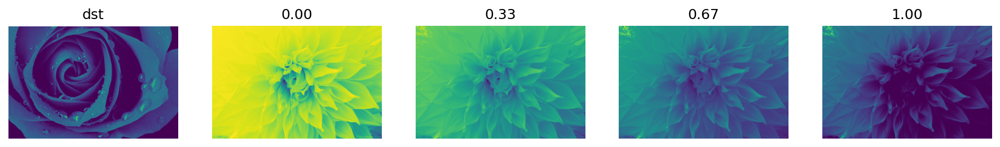

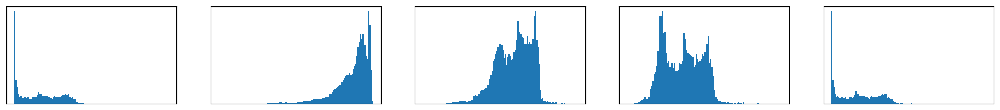

Time: 0.5476884841918945


In [11]:
# Visualize the effect of weighting on a single channel
path = 'DeepPhotoStyleTransfer'
src = plt.imread(pj(path, 'input', f'in9.png'))
dst = plt.imread(pj(path, 'style', f'tar9.png'))
steps = 4

src = np.expand_dims(convert_colorspace(src.copy(), 'rgb', 'lab')[..., 0], axis=-1)
dst = np.expand_dims(convert_colorspace(dst.copy(), 'rgb', 'lab')[..., 0], axis=-1)

# Prevent duplicates in source and target [optionally]
# Try to comment the following line to see the changes in the transformed distribution when the
# duplicates of the array that is being transformed are not resolved first. The dst array is 
# used here only to learn the transformation function and duplicates on its lattice are resolved
# automatically within Redistributor already, so no need to adjust the dst array here.
src = make_unique(src.ravel(), assume_sorted=False, return_original_order=True).reshape(src.shape)
# dst = make_unique(dst.ravel(), assume_sorted=False, return_original_order=True).reshape(dst.shape)

outs = [dst]
weights = np.linspace(0, 1, steps)
st = time.time()
for w in weights:
    out = match_per_channel(src.copy(), dst, weight=w)
    outs.append(out.copy())
et = time.time()

names= ['dst', *[f'{x:.2f}' for x in weights]]
show_row(outs, names=names, dpi=150)

plt.figure(figsize=(20,2), dpi=100)
for i in range(steps+1):
    plt.subplot(1,steps+1,i+1)
    plt.hist(outs[i].ravel(), bins=128)
    # plt.ylim(None, 10000)
    # plt.xlim(0, 1)
    plt.yticks([])
    plt.xticks([])
plt.show(); plt.close()

print('Time:', et - st)

# Advanced Sequential Transformations

In [12]:
def match_sequential_SLRGBLx3_unique(src, dst, mask_src=None, mask_dst=None, mask_whitelist=None):
    """
    Advanced sequential transformation using Redistributor across HSV, LAB, and RGB colorspaces.
    First gaussian noise of very small magnitude is applied to duplicate values of both src and dst.
    Then 3 iterations of the following redistribution sequence are applied:
        Saturation channel (in HSV)
        Lightness channel (in LAB) 
        Each of RGB channels separately 
        Lightness channel (in LAB) again
    In case masks are specified, the redistribution occurs only between the same regions in src and dst
    following the region specification in the multi-class masks. If mask_whitelist is used, it allows
    the user to apply the redistribution only on the whitelisted mask regions instead of all.
    """
    src = make_unique(src.ravel(), assume_sorted=False, return_original_order=True).reshape(src.shape)
    out = src.copy()
    ms, md, mw = mask_src, mask_dst, mask_whitelist
    for i in range(3):
        out = match(out, dst, channels=(1, ), colorspace='hsv', mask_src=ms, mask_dst=md, mask_whitelist=mw)
        out = match(out, dst, channels=(0, ), colorspace='lab', mask_src=ms, mask_dst=md, mask_whitelist=mw)
        out = match(out, dst, channels=(slice(None), ), mode='separate', colorspace='rgb', mask_src=ms, mask_dst=md, mask_whitelist=mw)
        out = match(out, dst, channels=(0, ), colorspace='lab', mask_src=ms, mask_dst=md, mask_whitelist=mw)
    return out

def match_sequential_SLRGBLx3_weighted_unique(src, dst, mask_src=None, mask_dst=None, mask_whitelist=None):
    """
    Advanced sequential transformation using Redistributor across HSV, LAB, and RGB colorspaces.
    Same as match_sequential_SLRGBLx3_unique(), check it's docstring, except weighting schedule is 
    introduced here per transformation and iteration. I.e. in the first iteration, the first transformation
    of the Saturation channel (in HSV) is performed and then weight-averaged with the original Saturation
    channel using the specified weight. Here 0.98 * original saturation + 0.02 * redistributed Saturation
    will be returned from the first call to match(). In the second iteration it will be 0.95 and 0.05, etc.
    Weighting helps reducing artifacts caused by heavily-skewed distributions of some channels.
    """
    src = make_unique(src.ravel(), assume_sorted=False, return_original_order=True).reshape(src.shape)
    out = src.copy()
    ms, md, mw = mask_src, mask_dst, mask_whitelist
    
    sw = [0.02, 0.05, 0.60]
    lw = [0.10, 0.50, 1.00]
    for i in range(3):
        out = match(out, dst, channels=(1, ), colorspace='hsv', mask_src=ms, mask_dst=md, mask_whitelist=mw, weights=[sw[i]])
        out = match(out, dst, channels=(0, ), colorspace='lab', mask_src=ms, mask_dst=md, mask_whitelist=mw, weights=[lw[i]])
        out = match(out, dst, channels=(slice(None), ), mode='separate', colorspace='rgb', mask_src=ms, mask_dst=md, mask_whitelist=mw, weights=[lw[i]])
        out = match(out, dst, channels=(0, ), colorspace='lab', mask_src=ms, mask_dst=md, mask_whitelist=mw, weights=[lw[i]])
    return out

# Redistributing in Fourier space

In [13]:
def match_fourier(src, dst, mode='separate', phases=False):
    from numpy.fft import fftn, ifftn, fftshift

    def P2R(radii, angles):
        # From amplitude & phase to spectrogram
        return radii * np.exp(1j*angles)

    def R2P(x):
        # From spectrogram to amplitude & phase
        return np.abs(x), np.angle(x)
        
    assert src.min() >= 0 and src.max() <= 1
    assert dst.min() >= 0 and dst.max() <= 1
    assert src.ndim == 3 and dst.ndim == 3

    # Compute the Fourier transform over all axes
    srcf = fftn(src)
    dstf = fftn(dst)

    # Get amplitudes & phases
    srca, srcp = R2P(srcf)
    dsta, dstp = R2P(dstf)

    if mode == 'separate':
        outa = match_per_channel(srca, dsta)
    elif mode == 'combined':
        outa = match_per_channel(
            np.expand_dims(srca.flatten(), -1),
            np.expand_dims(dsta.flatten(), -1)
            ).reshape(srca.shape)
    if phases:
        if mode == 'separate':
            outp = match_per_channel(srcp, dstp)
        elif mode == 'combined':
            outp = match_per_channel(
                np.expand_dims(srcp.flatten(), -1),
                np.expand_dims(dstp.flatten(), -1)
                ).reshape(srcp.shape)
    else:     
        outp = srcp

    # Back to complex valued matrix
    outc = P2R(outa, outp)

    # Back to image space
    out = ifftn(outc).real
    out = np.clip(out, 0, 1)

    return out

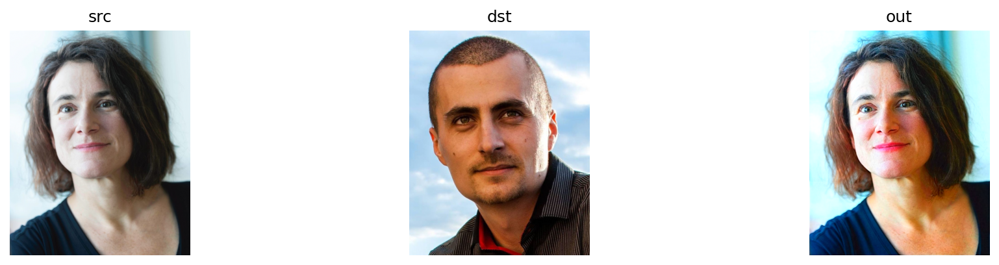

separate - 2s | src: (1000, 800), dst: (1000, 800)


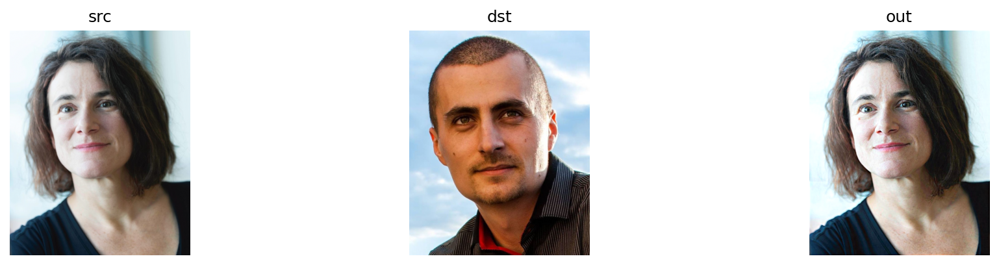

combined - 2s | src: (1000, 800), dst: (1000, 800)


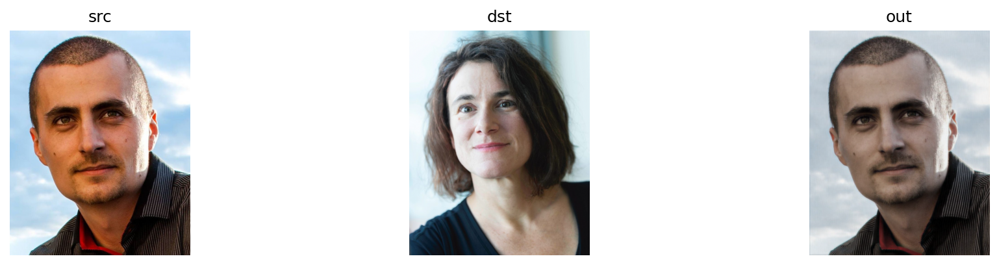

separate - 2s | src: (1000, 800), dst: (1000, 800)


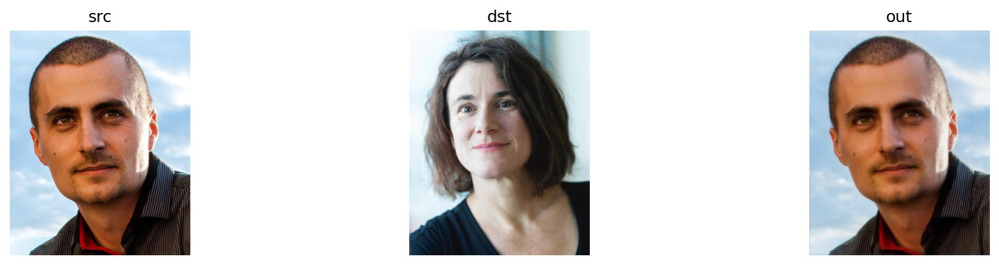

combined - 2s | src: (1000, 800), dst: (1000, 800)


In [15]:
from itertools import product
files = ['monikadoerfler_100-125.jpg', 'pavolharar_100-125.jpg']


for file1, file2 in product(files, files):
    if file1 == file2:
        continue
    path = 'Portraits'
    src = plt.imread(pj(path, file1)) / 255
    dst = plt.imread(pj(path, file2)) / 255
    for mode in ['separate', 'combined']: 
        st = time.time()
        out = match_fourier(src.copy(), dst, mode=mode)
        plt.imsave(pj(path, f'r_{mode}_{file1}'), out)
        et = time.time()
        show_row([src, dst, out], ['src', 'dst', 'out'], dpi=150)
        print(f'{mode} - {et - st:.0f}s | src: {src.shape[:2]}, dst: {dst.shape[:2]}')

# Comparison on Photorealistic Style Transfer

Comparing Redistributor in the task of photorealistic style transfer with an NST-based method adjusted for this task.

Paper: https://arxiv.org/abs/1703.07511 \
Repo containing the data: https://github.com/luanfujun/deep-photo-styletransfer

In [16]:
import warnings
warnings.filterwarnings(action='ignore')

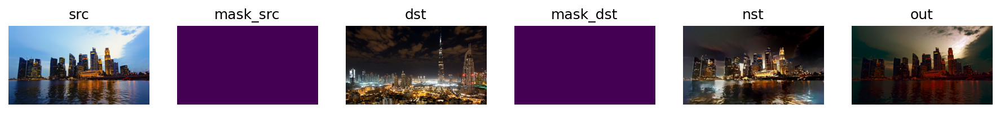

↑ File: 7, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (393, 700), dst: (393, 700) | time: 3s
------






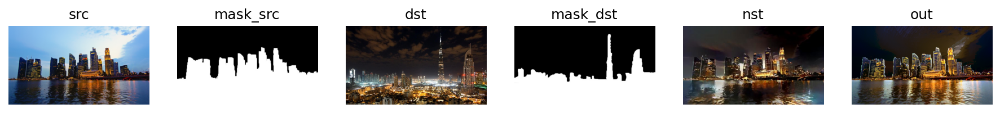

↑ File: 7, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (393, 700), dst: (393, 700) | time: 4s
------






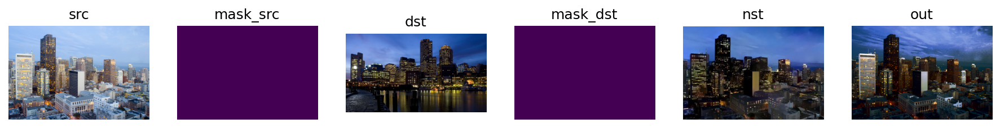

↑ File: 3, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (468, 700), dst: (393, 700) | time: 5s
------






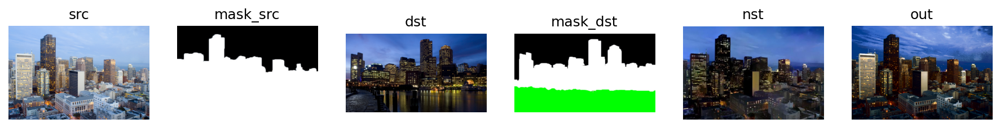

↑ File: 3, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (468, 700), dst: (393, 700) | time: 6s
------






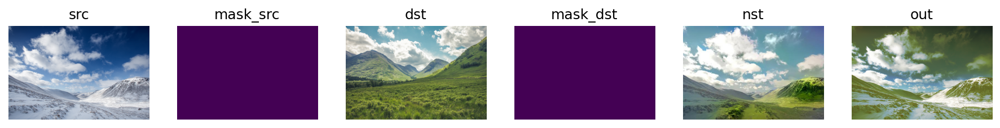

↑ File: 15, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (466, 700), dst: (466, 700) | time: 6s
------






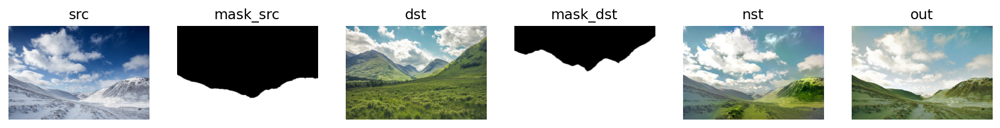

↑ File: 15, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (466, 700), dst: (466, 700) | time: 6s
------






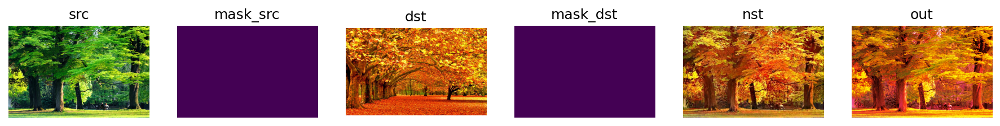

↑ File: 57, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (460, 700), dst: (437, 700) | time: 6s
------






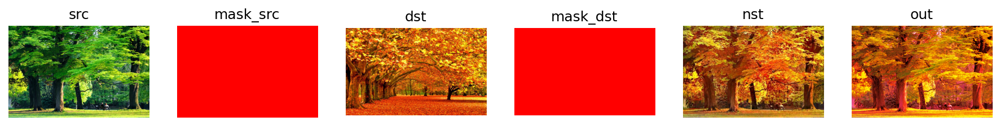

↑ File: 57, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (460, 700), dst: (437, 700) | time: 6s
------






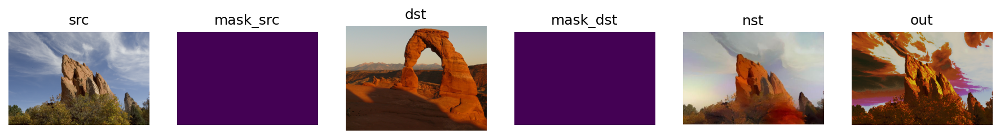

↑ File: 14, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (466, 700), dst: (525, 700) | time: 7s
------






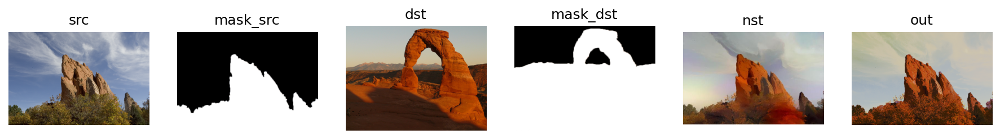

↑ File: 14, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (466, 700), dst: (525, 700) | time: 7s
------






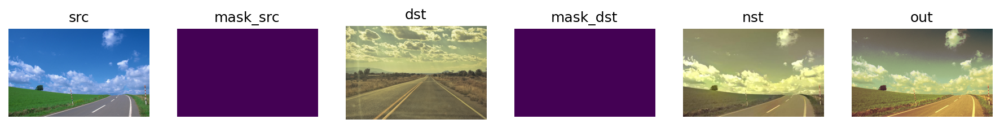

↑ File: 32, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (437, 700), dst: (467, 700) | time: 5s
------






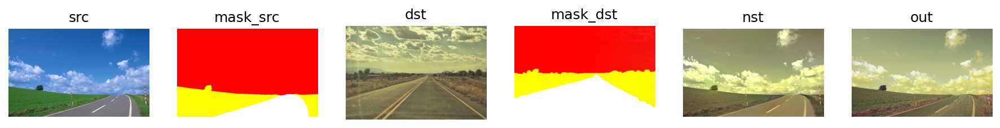

↑ File: 32, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (437, 700), dst: (467, 700) | time: 6s
------






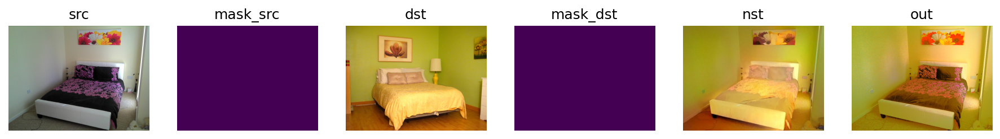

↑ File: 30, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (525, 700), dst: (525, 700) | time: 6s
------






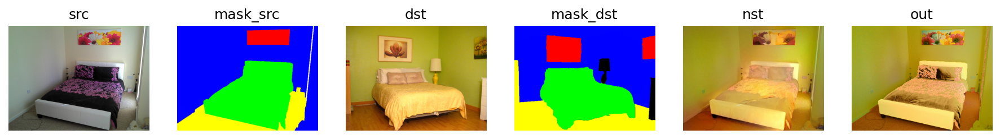

↑ File: 30, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (525, 700), dst: (525, 700) | time: 7s
------






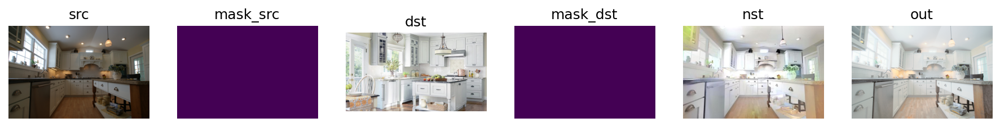

↑ File: 40, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (465, 700), dst: (393, 700) | time: 5s
------






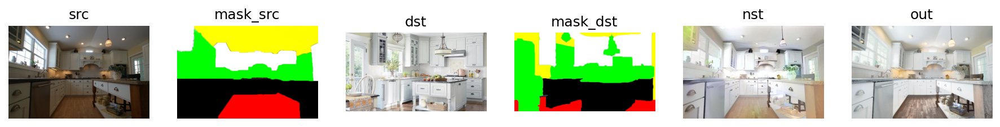

↑ File: 40, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (465, 700), dst: (393, 700) | time: 7s
------






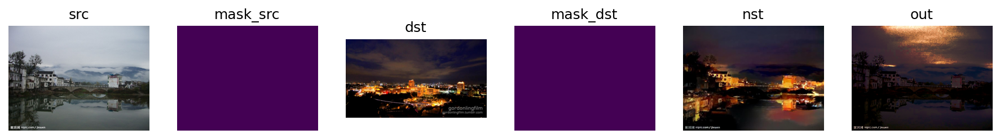

↑ File: 5, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (525, 700), dst: (393, 700) | time: 6s
------






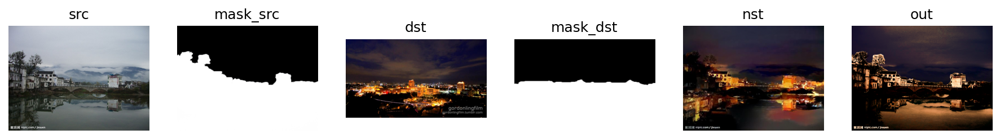

↑ File: 5, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (525, 700), dst: (393, 700) | time: 5s
------






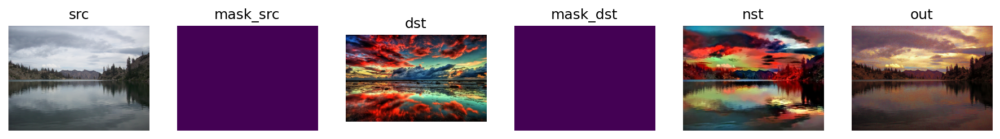

↑ File: 13, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (525, 700), dst: (437, 700) | time: 6s
------






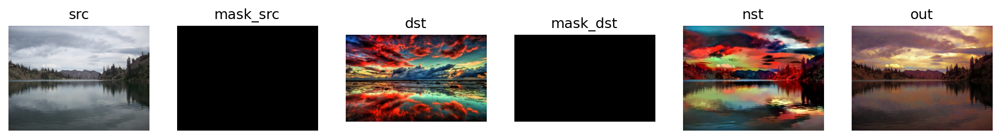

↑ File: 13, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (525, 700), dst: (437, 700) | time: 6s
------






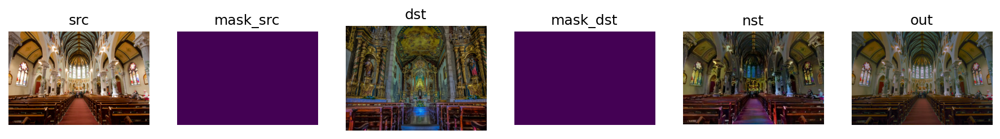

↑ File: 39, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (466, 700), dst: (524, 700) | time: 6s
------






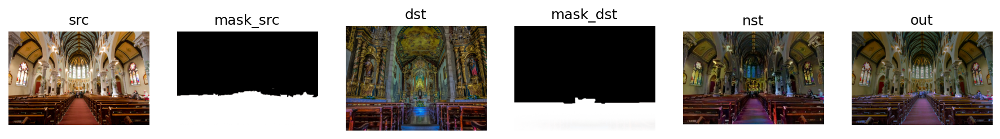

↑ File: 39, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (466, 700), dst: (524, 700) | time: 7s
------






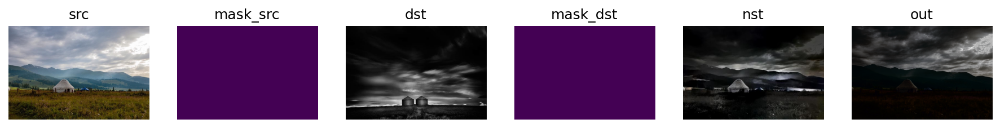

↑ File: 47, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (466, 700), dst: (467, 700) | time: 6s
------






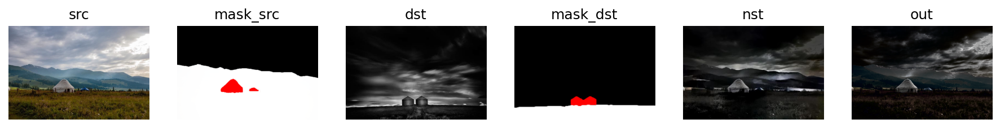

↑ File: 47, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (466, 700), dst: (467, 700) | time: 6s
------






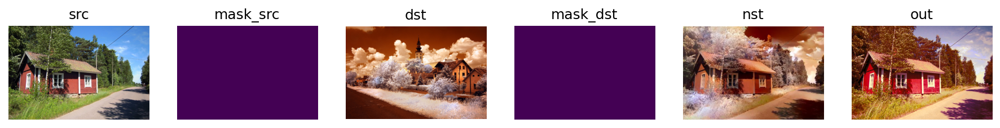

↑ File: 51, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (468, 700), dst: (465, 700) | time: 7s
------






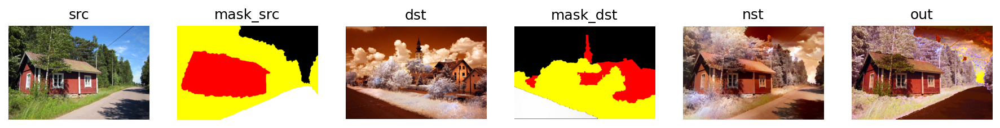

↑ File: 51, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (468, 700), dst: (465, 700) | time: 7s
------






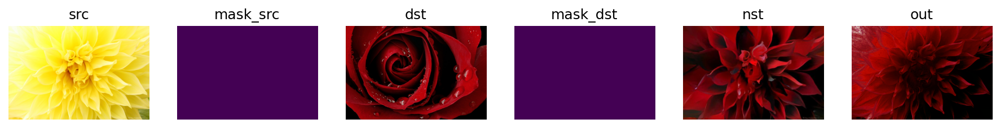

↑ File: 9, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (467, 700), dst: (466, 700) | time: 5s
------






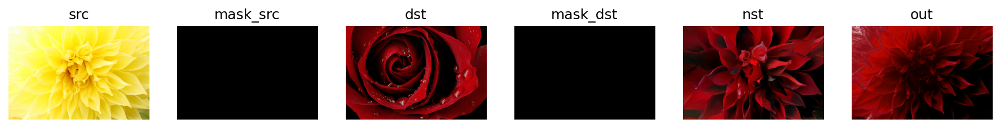

↑ File: 9, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (467, 700), dst: (466, 700) | time: 6s
------






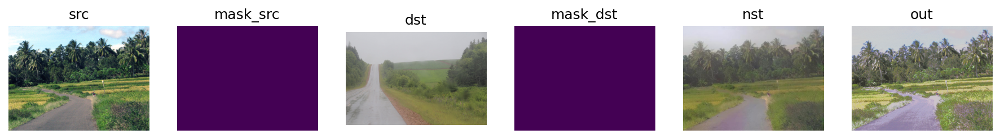

↑ File: 52, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (525, 700), dst: (466, 700) | time: 6s
------






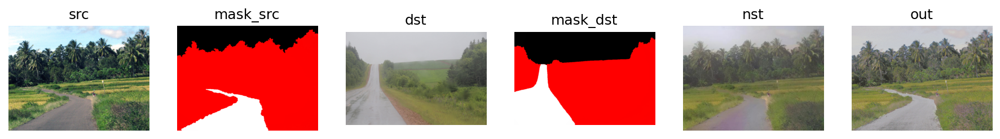

↑ File: 52, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (525, 700), dst: (466, 700) | time: 7s
------






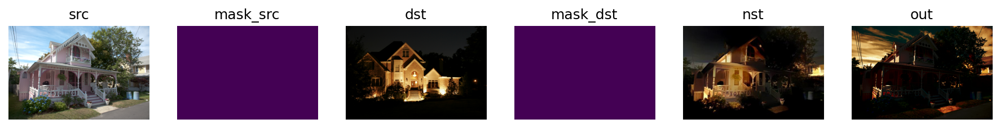

↑ File: 20, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: False | src: (466, 700), dst: (466, 700) | time: 6s
------






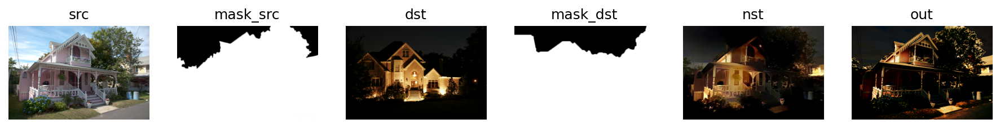

↑ File: 20, Func: match_sequential_SLRGBLx3_weighted_unique | Masking: True | src: (466, 700), dst: (466, 700) | time: 6s
------






In [17]:
path = 'DeepPhotoStyleTransfer'

# Colors that the NST paper used in their respective masks (we use int masks instead of RGB masks)
file_ids_to_src_mask_regions = {7: (0, 8), 3: (0, 8), 15: (0, 8), 57: (4,), 14: (0, 8), 32: (8, 6, 4), 30: (6, 4, 3, 2), 40: (8, 0, 6, 3, 4), 5: (0, 8), 13: (0,), 39: (0, 8), 47: (0, 8, 4), 51: (0, 8, 4, 6), 9: (0,), 52: (0, 8, 4), 20: (0, 8)}
file_ids_to_dst_mask_regions = {7: (0, 8), 3: (0, 8, 3), 15: (0, 8), 57: (4,), 14: (0, 8), 32: (8, 6, 4), 30: (6, 4, 3, 2, 0), 40: (8, 0, 6, 3, 4), 5: (0, 8), 13: (0,), 39: (0, 8), 47: (0, 8, 4), 51: (0, 8, 4, 6), 9: (0,), 52: (0, 8, 4), 20: (0, 8)}

# Files to visualize (using all image they used in their paper in figures 4 and 5; also keeping their order)
file_ids = [7, 3, 15, 57, 14, 32, 30, 40, 5, 13, 39, 47, 51, 9, 52, 20]

funcs = (
    # match_sequential_SLRGBLx3_unique,  # 18 distinct redistributions per call
    match_sequential_SLRGBLx3_weighted_unique,  # 18 distinct redistributions per call
)

for id in file_ids:
    for masking in [False, True]:
        src = plt.imread(pj(path, 'input', f'in{id}.png'))
        dst = plt.imread(pj(path, 'style', f'tar{id}.png'))
        nst = plt.imread(pj(path, 'auto_seg', f'our{id}.jpg')) / 255
        if masking:
            mask_src_rgb = (plt.imread(pj(path, 'segmentation', f'in{id}.png')) * 255).astype(np.uint8)
            mask_dst_rgb = (plt.imread(pj(path, 'segmentation', f'tar{id}.png')) * 255).astype(np.uint8)
            mask_src = maskRGB_to_mask(mask_src_rgb, used_colors_idx=file_ids_to_src_mask_regions[id])
            mask_dst = maskRGB_to_mask(mask_dst_rgb, used_colors_idx=file_ids_to_dst_mask_regions[id])
            assert src.shape == mask_src.shape, f'{src.shape} != {mask_src.shape}'
            assert dst.shape == mask_dst.shape, f'{dst.shape} != {mask_dst.shape}'
        else:
            mask_src = mask_dst = None

        for func in funcs:
            st = time.time()
            out = func(src.copy(), dst, mask_src, mask_dst, mask_whitelist=None)
            plt.imsave(pj(path, 'results', f'res{id}-{func.__name__}{"-mask" if masking else ""}.png'), out)
            et = time.time()
            if masking:
                show_row([src, mask_src_rgb, dst, mask_dst_rgb, nst, out], ['src', 'mask_src', 'dst', 'mask_dst', 'nst', 'out'], dpi=150)
            else:
                show_row([src, np.ones_like(src)[...,0], dst, np.ones_like(src)[...,0], nst, out], ['src', 'mask_src', 'dst', 'mask_dst', 'nst', 'out'], dpi=150)
            print(f'↑ File: {id}, Func: {func.__name__} | Masking: {masking} | src: {src.shape[:2]}, dst: {dst.shape[:2]} | time: {et - st:.0f}s')
        print('------\n\n\n\n')

# Comparison on Color Correction

Below we demonstrate the performance of Redistributor on a data set for color mapping with available reference and ground truth images.

The data set comprises 3 sets of images:
* SET 1: A scene with varying shutter speed of the camera (7 images - 1/10s, 1/100s, 1/200s, 1/400s, 1/800s, 1/1600s, 1/3200s)
* SET 2: A scene with varying illumination & shutter speed (7 images - Illumination D65 to Illumination A, speeds from SET 1)
* SET 3: A scene with varying color temperature of the camera (5 images - 4500K, 4000K, 3500K, 3000K, 2500K)

The test images in each set are accompanied by two properly illuminated images (reference and ground truth) using an appropriate shutter speed and color temperature. \
The reference image is of the same scene but taken from a different angle, while the ground truth image is of the same scene and taken from the same angle as the test image. \
The task is to transform the test image using the information from the reference image such that it minimizes the ΔE00 (CIE 2000) metric between the transformed image and the ground truth. I.e.:\
$minimize ΔE00(f(test, ref), ground)$

Our results (Redistributor & Redistributor utilizing a mask) are presented in contrast with 5 other methods, results of which were taken from the Figure 14, 15, and 16 of the data set paper (doi:10.1111/cgf.12671). \
Results are visualized using a box plot for each set of images. Each box shows a median ΔE00, 25th and 75th percentiles. \
For whiskers we use the default value of 1.5 which corresponds to approximately +/- 2.7 sigma and 99.3 coverage if the data are normally distributed.

The review paper presenting the data set and results of other methods: https://doi.org/10.1111/cgf.12671 \
Data set download: https://sites.google.com/site/reviewcolormapping/ \
DeltaE metric implementation: https://colour.readthedocs.io/en/latest/_modules/colour/difference/delta_e.html

In [18]:
our_results = {}

Computing results for func: match_sequential_SLRGBLx3_unique
	On the: set1


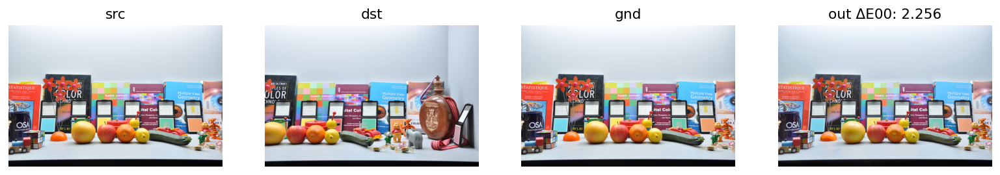

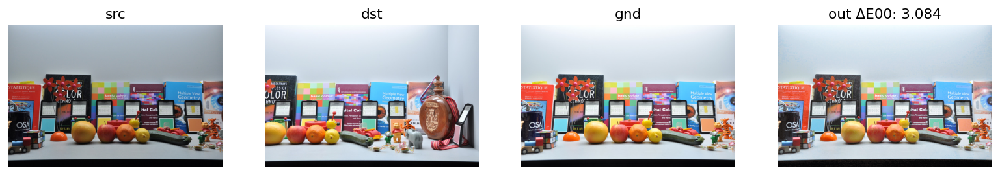

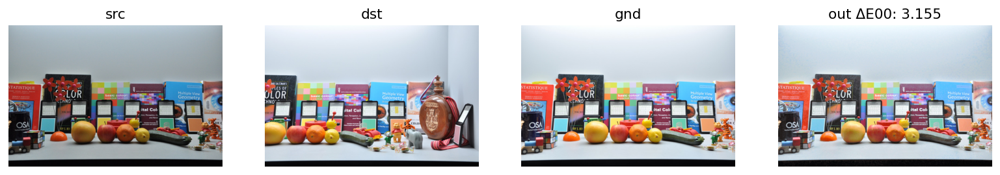

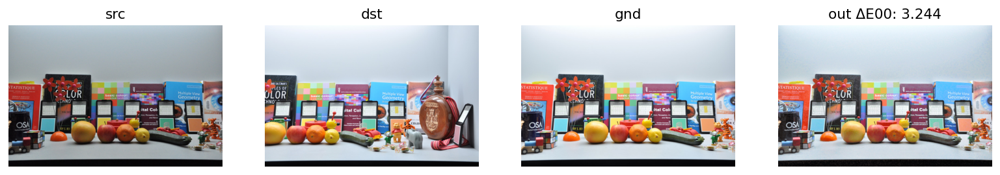

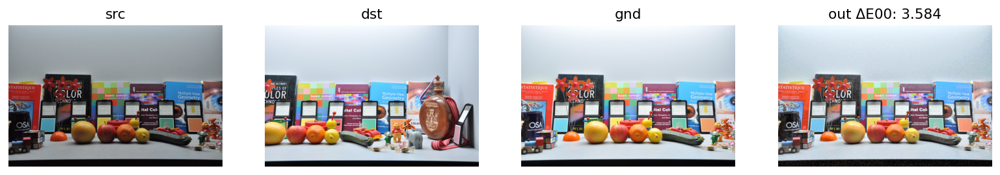

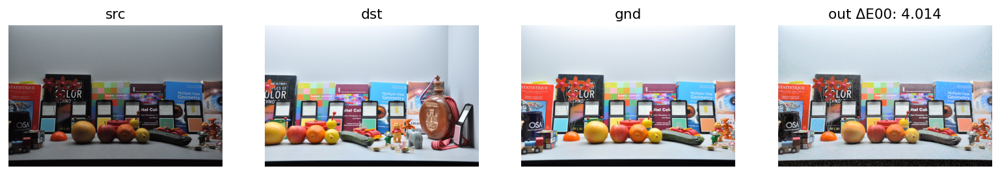

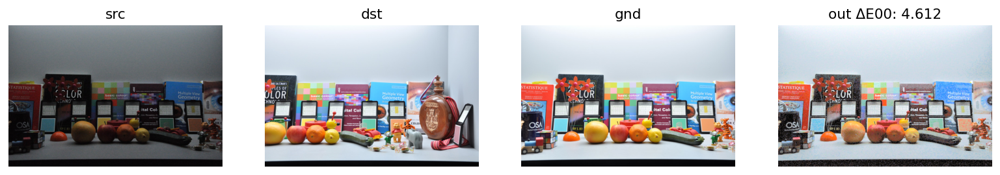

	Medians: [2.2560729086669471, 3.0838473853969401, 3.1547108760243106, 3.2438826096646713, 3.5835138329410401, 4.0141695149744221, 4.6121517757069537]
	On the: set2


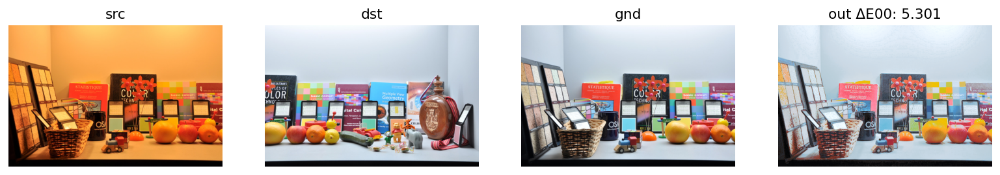

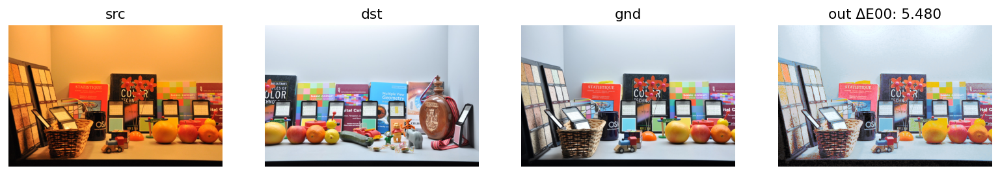

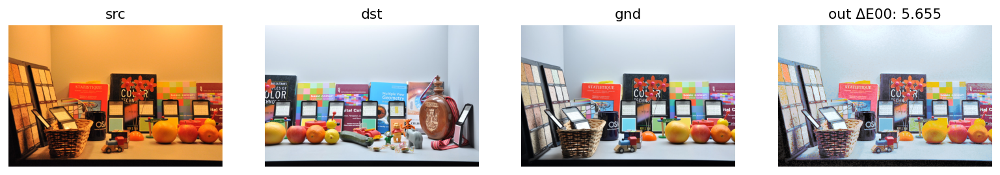

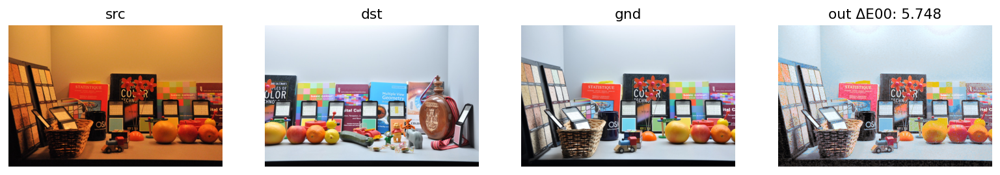

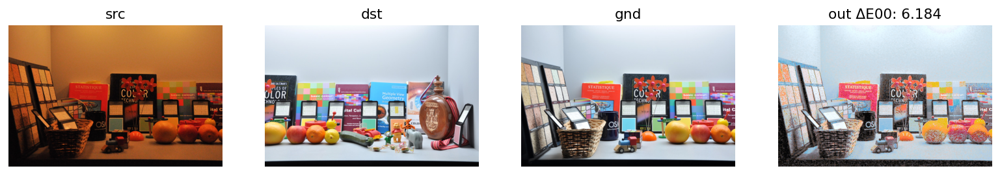

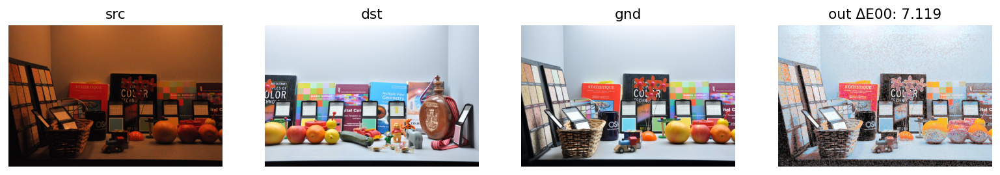

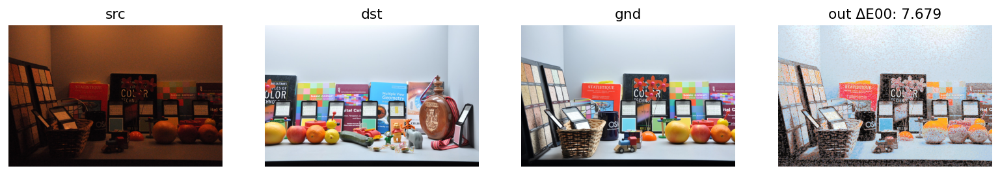

	Medians: [5.3011369718891768, 5.4797566345119719, 5.6553317603189619, 5.7478903291266672, 6.1842752349880943, 7.1192796515626444, 7.6788024228212794]
	On the: set3


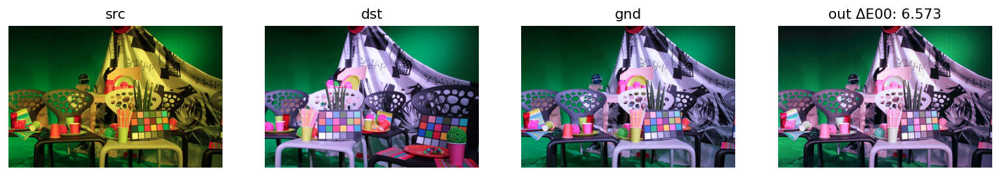

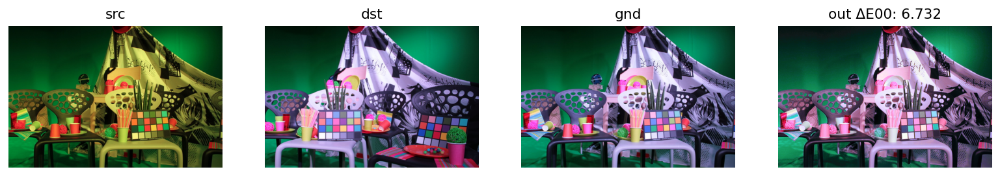

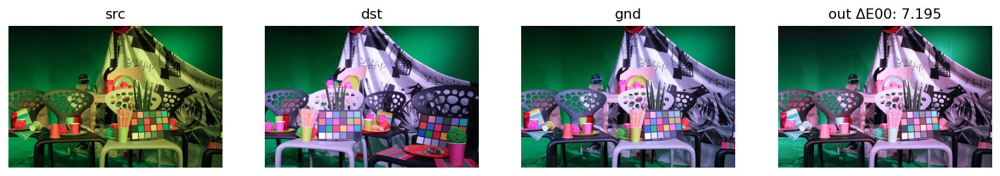

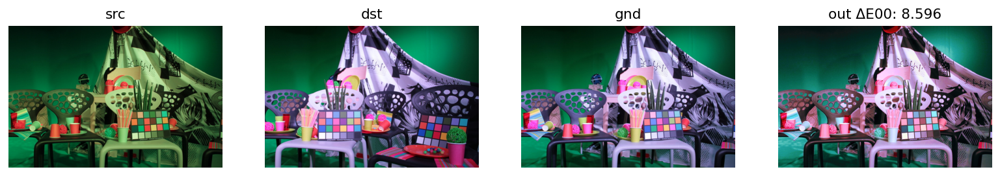

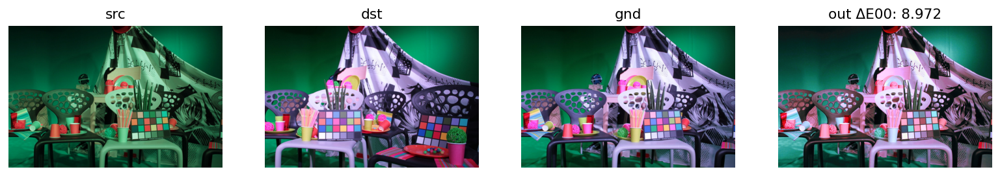

	Medians: [6.5734323484116128, 6.7323651001080478, 7.1949217327567894, 8.5961328915410871, 8.9717140394388881]
Computing results for func: match_sequential_SLRGBLx3_unique-mask
	On the: set1


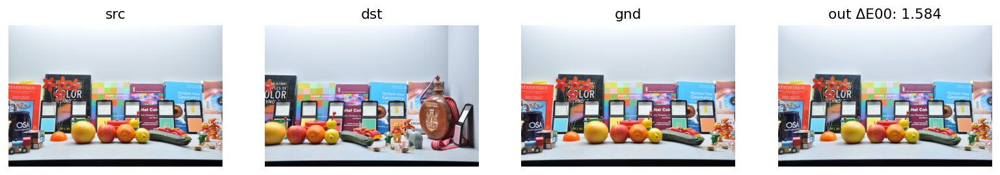

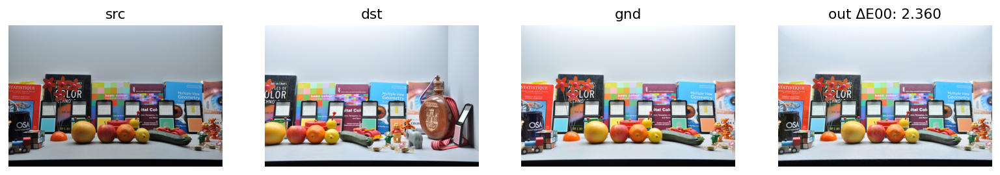

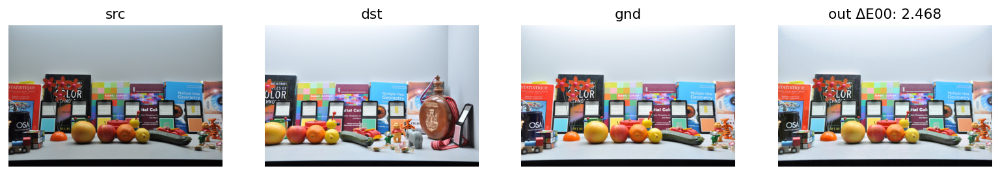

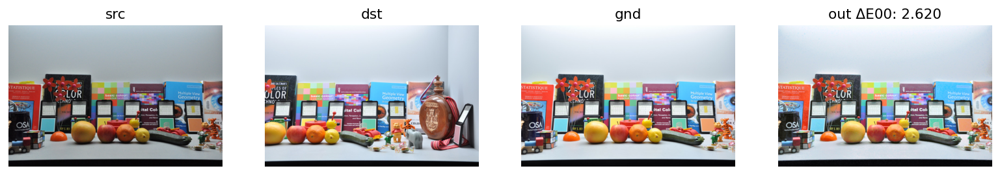

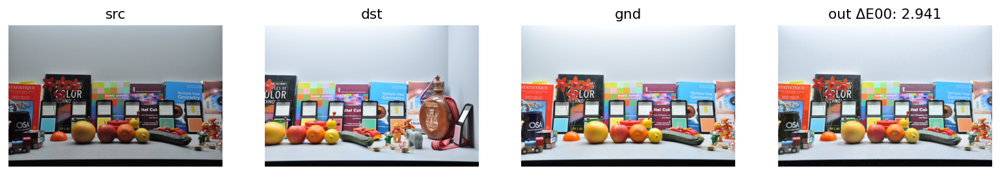

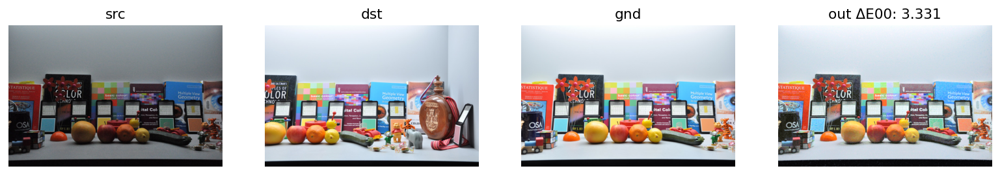

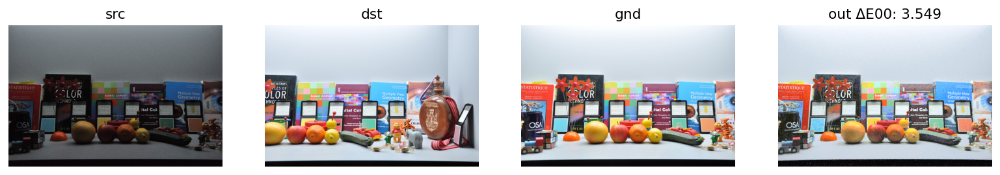

	Medians: [1.5835571268532529, 2.3602269407914731, 2.4683121384917399, 2.6204971118889446, 2.9409271120460385, 3.3308922897789279, 3.5493323740635563]
	On the: set2


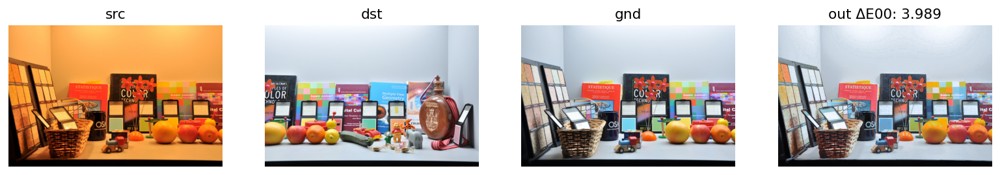

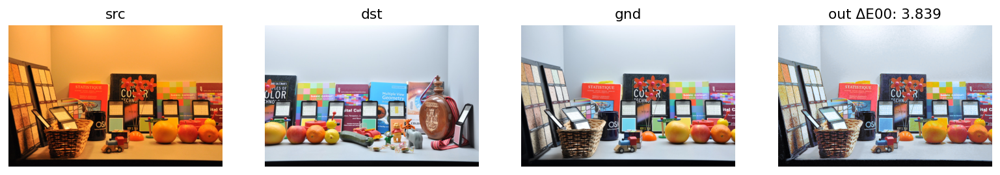

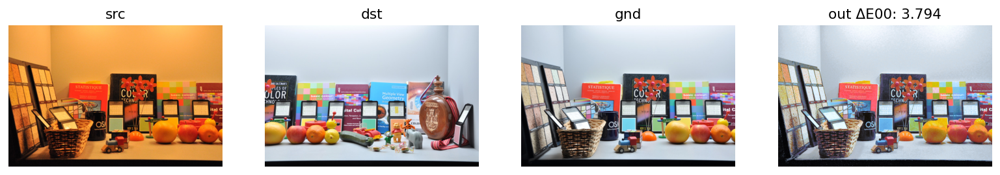

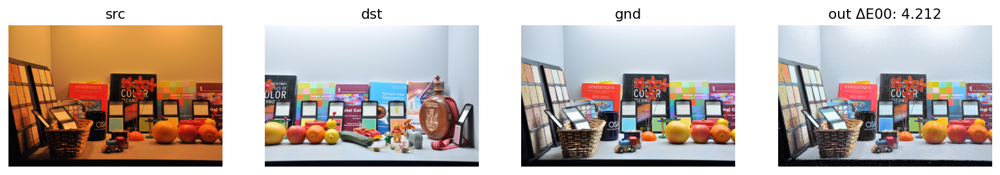

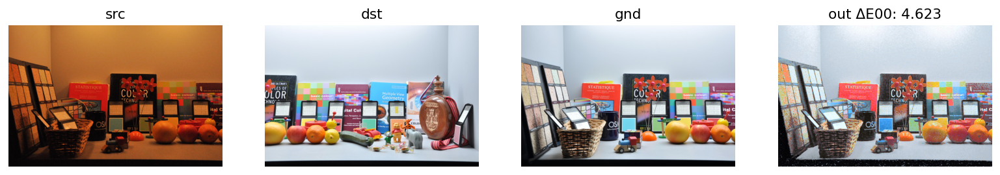

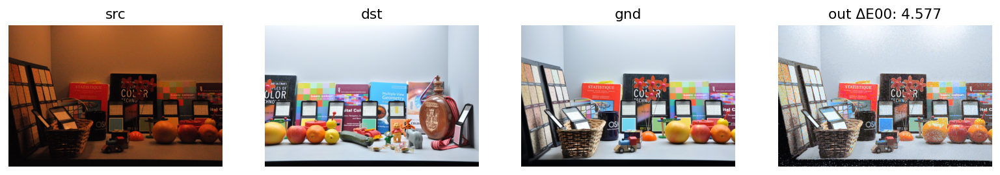

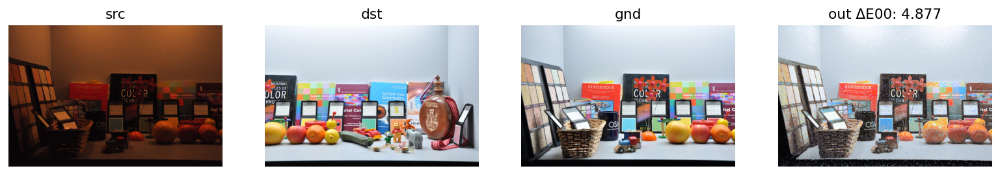

	Medians: [3.9887842313382054, 3.8387451784259907, 3.7935747354210489, 4.2115440676800127, 4.623070903996382, 4.5768622841895858, 4.87741419606043]
	On the: set3


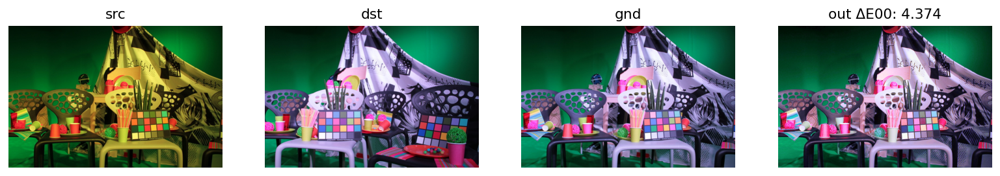

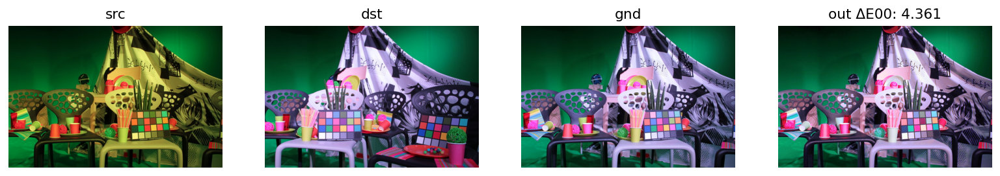

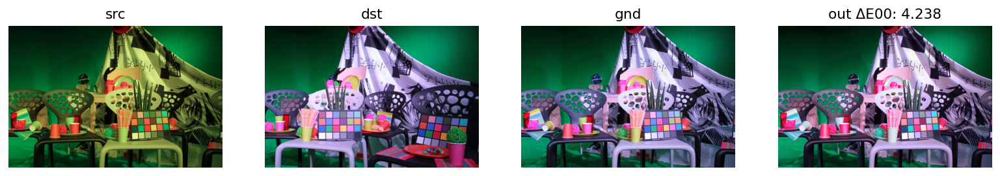

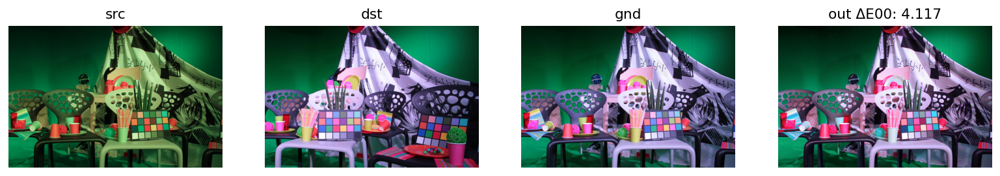

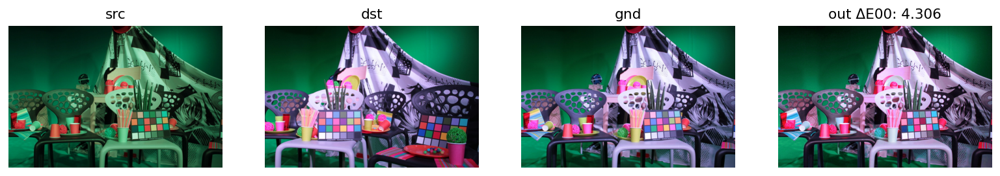

	Medians: [4.3742025428834328, 4.3607454484995527, 4.2375756219049734, 4.1173278709903043, 4.3064590610992397]


In [19]:
path = 'ColorMappingDataset'

functions = [
    match_sequential_SLRGBLx3_unique,
    # match_sequential_SLRGBLx3_weighted_unique,
]

tasks = {
    'set1': [1, 2, 3, 4, 5, 6, 7],
    'set2': [36, 37, 38, 39, 40, 41, 42],
    'set3': [111, 112, 113, 114, 115],
}

# The masks were created by us manually in photopea.com
# Check the code of maskRGB_to_mask() to see the map from int to RGB
file_ids_to_src_mask_regions = {1: (4, 3, 2), 36: (4, 3, 2), 111: (4, 3)}
file_ids_to_dst_mask_regions = {1: (4, 3, 2), 2: (4, 3, 2, 8), 111: (4, 3)}

id_to_src_maskid = {
    'set1': {1: 1, 2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1},
    'set2': {36: 36, 37: 36, 38: 36, 39: 36, 40: 36, 41: 36, 42: 36},
    'set3': {111: 111, 112: 111, 113: 111, 114: 111, 115: 111}}
id_to_dst_maskid = {
    'set1': {1: 2, 2: 2, 3: 2, 4: 2, 5: 2, 6: 2, 7: 2},
    'set2': {36: 1, 37: 1, 38: 1, 39: 1, 40: 1, 41: 1, 42: 1},
    'set3': {111: 111, 112: 111, 113: 111, 114: 111, 115: 111}}


# Change of intensities by changing the shutter speed of the camera
# Shutter Speed: '1/10s','1/100s','1/200s','1/400s','1/800s','1/1600s','1/3200s' respectively
file_ids_set1 = [1, 2, 3, 4, 5, 6, 7]

# Change of Illumination (Illumination D65 to Illumination A)
# Shutter Speed: '1/10s','1/100s','1/200s','1/400s','1/800s','1/1600s','1/3200s' respectively
file_ids_set2 = [36, 37, 38, 39, 40, 41, 42]

# Change of white balance by varying the color temparature of the camera.
# White Balance: {'4500K','4000K','3500K','3000K','2500K'} respectively 
file_ids_set3 = [111, 112, 113, 114, 115]

for masking in [False, True]:
    for func in functions:
        funcname = f'{func.__name__}{"-mask" if masking else ""}'
        our_results[funcname] = {'set1': {}, 'set2': {}, 'set3': {}}
        print(f'Computing results for func: {funcname}')
        for image_set in ['set1', 'set2', 'set3']:
            print(f'\tOn the: {image_set}')
            file_ids = tasks[image_set]
            medians = []
            for id in file_ids:
                src = plt.imread(pj(path, 'testImages', f'test{id}.JPG')) / 255
                dst = plt.imread(pj(path, 'testImages', f'ref{id}.JPG')) / 255
                gnd = plt.imread(pj(path, 'testImages', f'true{id}.JPG')) / 255
    
                if masking:
                    mask_src = maskRGB_to_mask(
                        (plt.imread(pj(path, 'segImages', f'test{id_to_src_maskid[image_set][id]}_seg.png')) * 255).astype(np.uint8)[:,:,:3], 
                        used_colors_idx=file_ids_to_src_mask_regions[id_to_src_maskid[image_set][id]])
                    mask_dst = maskRGB_to_mask(
                        (plt.imread(pj(path, 'segImages', f'ref{id_to_dst_maskid[image_set][id]}_seg.png')) * 255).astype(np.uint8)[:,:,:3], 
                        used_colors_idx=file_ids_to_dst_mask_regions[id_to_dst_maskid[image_set][id]])
                    assert src.shape == mask_src.shape, f'{src.shape} != {mask_src.shape}'
                    assert dst.shape == mask_dst.shape, f'{dst.shape} != {mask_dst.shape}'
                else:
                    mask_src = mask_dst = None
    
                out = func(src, dst, mask_src, mask_dst, mask_whitelist=(4,3,2))
                plt.imsave(pj(path, 'results', f'res{id}-{funcname}.JPG'), out)
                deltaE = colour.delta_E(convert_colorspace(out, 'rgb', 'lab'),
                                        convert_colorspace(gnd, 'rgb', 'lab'))
                med = np.median(deltaE.ravel())
                medians.append(med)
                our_results[funcname][image_set][id] = deltaE
                show_row([src, dst, gnd, out], names=['src', 'dst', 'gnd', f'out ΔE00: {med:.3f}'], dpi=130)
            print(f'\tMedians: {list(medians)}')

(-1.0, 30.0)

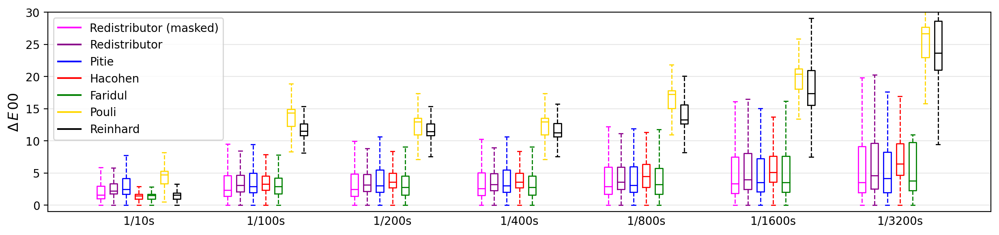

In [20]:
# FIGURE OF SET1

setf = 'match_sequential_SLRGBLx3_unique'
# setf = 'match_sequential_SLRGBLx3_weighted_unique'

image_set = 'set1'
fis = file_ids_set1
n_boxes_per_image = 7
bw = 0.07 # box width
step=0.12 # space between boxes

fig, ax = plt.subplots()
fig.set_figheight(3.2)
fig.set_figwidth(15)
fig.set_dpi(200)
our_deltas = [our_results[setf][image_set][id].ravel() for id in fis]
our_deltas_masked = [our_results[setf+'-mask'][image_set][id].ravel() for id in fis]
positions = np.array(range(len(our_deltas))) * 1.2

# Values of competing methods were read out from the boxplots of the review paper
set1_blue = [
    {'whislo': 0.0, 'q1': 1.74, 'med': 2.46, 'q3': 4.18, 'whishi': 7.79},
    {'whislo': 0.0, 'q1': 1.99, 'med': 2.94, 'q3': 4.99, 'whishi': 9.46},
    {'whislo': 0.0, 'q1': 2.03, 'med': 3.03, 'q3': 5.51, 'whishi': 10.64},
    {'whislo': 0.0, 'q1': 2.04, 'med': 3.03, 'q3': 5.52, 'whishi': 10.65},
    {'whislo': 0.0, 'q1': 2.03, 'med': 3.09, 'q3': 5.98, 'whishi': 11.94},
    {'whislo': 0.0, 'q1': 2.07, 'med': 3.55, 'q3': 7.28, 'whishi': 15.08},
    {'whislo': 0.0, 'q1': 1.99, 'med': 4.19, 'q3': 8.29, 'whishi': 17.65}
]
set1_red = [
    {'whislo': 0.0, 'q1': 0.94, 'med': 1.46, 'q3': 1.75, 'whishi': 2.94},
    {'whislo': 0.0, 'q1': 2.37, 'med': 3.27, 'q3': 4.56, 'whishi': 7.9},
    {'whislo': 0.0, 'q1': 2.75, 'med': 3.59, 'q3': 5.00, 'whishi': 8.41},
    {'whislo': 0.0, 'q1': 2.76, 'med': 3.59, 'q3': 4.99, 'whishi': 8.4},
    {'whislo': 0.0, 'q1': 2.77, 'med': 4.47, 'q3': 6.35, 'whishi': 11.33},
    {'whislo': 0.0, 'q1': 3.61, 'med': 5.09, 'q3': 7.66, 'whishi': 13.74},
    {'whislo': 0.0, 'q1': 4.71, 'med': 6.45, 'q3': 9.61, 'whishi': 16.93}
]
set1_green = [
    {'whislo': 0.0, 'q1': 0.98, 'med': 1.56, 'q3': 1.74, 'whishi': 2.84},
    {'whislo': 0.0, 'q1': 1.79, 'med': 2.94, 'q3': 4.23, 'whishi': 7.84},
    {'whislo': 0.0, 'q1': 1.59, 'med': 2.79, 'q3': 4.56, 'whishi': 9.09},
    {'whislo': 0.0, 'q1': 1.59, 'med': 2.79, 'q3': 4.56, 'whishi': 9.07},
    {'whislo': 0.0, 'q1': 1.7, 'med': 3.21, 'q3': 5.76, 'whishi': 11.8},
    {'whislo': 0.0, 'q1': 2.03, 'med': 3.57, 'q3': 7.66, 'whishi': 16.19},
    {'whislo': 0.0, 'q1': 2.28, 'med': 3.79, 'q3': 9.78, 'whishi': 10.95}
]
set1_yellow = [
    {'whislo': 0.5, 'q1': 3.37, 'med': 4.75, 'q3': 5.32, 'whishi': 8.18},
    {'whislo': 8.31, 'q1': 12.28, 'med': 14.37, 'q3': 14.94, 'whishi': 18.87},
    {'whislo': 7.13, 'q1': 10.97, 'med': 12.98, 'q3': 13.55, 'whishi': 17.37},
    {'whislo': 7.13, 'q1': 10.98, 'med': 13.00, 'q3': 13.57, 'whishi': 17.37},
    {'whislo': 10.98, 'q1': 15.08, 'med': 17.25, 'q3': 17.81, 'whishi': 21.87},
    {'whislo': 13.44, 'q1': 18.1, 'med': 20.43, 'q3': 21.21, 'whishi': 25.85},
    {'whislo': 15.84, 'q1': 22.96, 'med': 26.72, 'q3': 27.68, 'whishi': 34.69}
]
set1_black = [
    {'whislo': 0.0, 'q1': 0.94, 'med': 1.61, 'q3': 1.9, 'whishi': 3.31},
    {'whislo': 8.13, 'q1': 10.84, 'med': 11.52, 'q3': 12.66, 'whishi': 15.37},
    {'whislo': 7.56, 'q1': 10.83, 'med': 11.5, 'q3': 12.65, 'whishi': 15.36},
    {'whislo': 7.56, 'q1': 10.67, 'med': 11.31, 'q3': 12.7, 'whishi': 15.76},
    {'whislo': 8.22, 'q1': 12.65, 'med': 13.27, 'q3': 15.6, 'whishi': 20.09},
    {'whislo': 7.51, 'q1': 15.59, 'med': 17.41, 'q3': 20.99, 'whishi': 29.06},
    {'whislo': 9.46, 'q1': 21.01, 'med': 23.67, 'q3': 28.66, 'whishi': 40.18}
]

# Add results per author
ax.boxplot(our_deltas_masked, positions=positions+step*0, widths=bw, medianprops={'color': 'fuchsia'}, boxprops={'color': 'fuchsia'}, whiskerprops={'color': 'fuchsia', 'linestyle': 'dashed'}, capprops={'color': 'fuchsia'}, showfliers=False)
ax.boxplot(our_deltas, positions=positions+step*1, widths=bw, medianprops={'color': 'darkmagenta'}, boxprops={'color': 'darkmagenta'}, whiskerprops={'color': 'darkmagenta', 'linestyle': 'dashed'}, capprops={'color': 'darkmagenta'}, showfliers=False)
ax.bxp(set1_blue, positions=positions+step*2, widths=bw, medianprops={'color': 'blue'}, boxprops={'color': 'blue'}, whiskerprops={'color': 'blue', 'linestyle': 'dashed'}, capprops={'color': 'blue'}, showfliers=False)
ax.bxp(set1_red, positions=positions+step*3, widths=bw, medianprops={'color': 'red'}, boxprops={'color': 'red'}, whiskerprops={'color': 'red', 'linestyle': 'dashed'}, capprops={'color': 'red'}, showfliers=False)
ax.bxp(set1_green, positions=positions+step*4, widths=bw, medianprops={'color': 'green'}, boxprops={'color': 'green'}, whiskerprops={'color': 'green', 'linestyle': 'dashed'}, capprops={'color': 'green'}, showfliers=False)
ax.bxp(set1_yellow, positions=positions+step*5, widths=bw, medianprops={'color': 'gold'}, boxprops={'color': 'gold'}, whiskerprops={'color': 'gold', 'linestyle': 'dashed'}, capprops={'color': 'gold'}, showfliers=False)
ax.bxp(set1_black, positions=positions+step*6, widths=bw, medianprops={'color': 'black'}, boxprops={'color': 'black'}, whiskerprops={'color': 'black', 'linestyle': 'dashed'}, capprops={'color': 'black'}, showfliers=False)

ax.set_ylabel(r'$Δ\,E\,00$', fontsize=12, fontfamily='serif')
tick_center_offset = ((n_boxes_per_image - 1) * step) / 2
plt.xticks(positions + tick_center_offset, ['1/10s', '1/100s', '1/200s', '1/400s', '1/800s', '1/1600s', '1/3200s'])
ax.tick_params(axis='x', length=0)
plt.yticks(range(0, 50, 5))

legend_entries = [
    ('Redistributor (masked)', plt.Line2D([0], [0], color='fuchsia')),
    ('Redistributor', plt.Line2D([0], [0], color='darkmagenta')),
    ('Pitie', plt.Line2D([0], [0], color='blue')),
    ('Hacohen', plt.Line2D([0], [0], color='red')),
    ('Faridul', plt.Line2D([0], [0], color='green')),
    ('Pouli', plt.Line2D([0], [0], color='gold')),
    ('Reinhard', plt.Line2D([0], [0], color='black')),
]
plt.grid(alpha=0.3, axis='y')
plt.legend(handles=[entry[1] for entry in legend_entries], labels=[entry[0] for entry in legend_entries])
plt.ylim(-1, 30)
plt.savefig(pj(path, 'results', f'set1_boxplot-{setf}.pdf'), bbox_inches='tight')

(-1.0, 60.0)

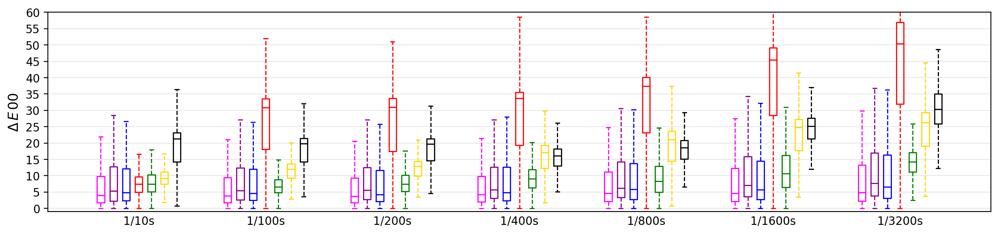

In [21]:
# FIGURE OF SET2

setf = 'match_sequential_SLRGBLx3_unique'
# setf = 'match_sequential_SLRGBLx3_weighted_unique'

image_set = 'set2'
fis = file_ids_set2
n_boxes_per_image = 7
bw = 0.07 # box width
step=0.12 # space between boxes

fig, ax = plt.subplots()
fig.set_figheight(3.2)
fig.set_figwidth(15)
fig.set_dpi(200)
our_deltas = [our_results[setf][image_set][id].ravel() for id in fis]
our_deltas_masked = [our_results[setf+'-mask'][image_set][id].ravel() for id in fis]
positions = np.array(range(len(our_deltas))) * 1.2

# Values of competing methods were read out from the boxplots of the review paper
set2_blue = [
    {'whislo': 0.00, 'q1': 2.41, 'med': 4.81, 'q3': 12.11, 'whishi': 26.61},
    {'whislo': 0.00, 'q1': 2.46, 'med': 4.61, 'q3': 12.00, 'whishi': 26.35},
    {'whislo': 0.00, 'q1': 2.14, 'med': 4.2, 'q3': 11.65, 'whishi': 25.83},
    {'whislo': 0.00, 'q1': 2.38, 'med': 4.91, 'q3': 12.61, 'whishi': 27.99},
    {'whislo': 0.00, 'q1': 2.78, 'med': 5.87, 'q3': 13.79, 'whishi': 30.19},
    {'whislo': 0.00, 'q1': 2.7, 'med': 5.72, 'q3': 14.46, 'whishi': 32.15},
    {'whislo': 0.00, 'q1': 3.09, 'med': 6.63, 'q3': 16.37, 'whishi': 36.29},
]
set2_red = [
    {'whislo': 0.00, 'q1': 5.01, 'med': 7.41, 'q3': 9.69, 'whishi': 16.66},
    {'whislo': 0.00, 'q1': 18.1, 'med': 30.81, 'q3': 33.53, 'whishi': 51.98},
    {'whislo': 0.00, 'q1': 17.46, 'med': 30.98, 'q3': 33.64, 'whishi': 51.08},
    {'whislo': 0.00, 'q1': 19.31, 'med': 33.68, 'q3': 35.49, 'whishi': 58.57},
    {'whislo': 0.00, 'q1': 23.17, 'med': 37.43, 'q3': 40.14, 'whishi': 58.57},
    {'whislo': 0.00, 'q1': 28.53, 'med': 45.4, 'q3': 49.17, 'whishi': 1000.00}, # The 1000 is made up (no data)
    {'whislo': 0.00, 'q1': 31.97, 'med': 50.38, 'q3': 56.91, 'whishi': 1000.00}, # The 1000 is made up (no data)
]
set2_green = [
    {'whislo': 0.00, 'q1': 5.05, 'med': 7.41, 'q3': 10.25, 'whishi': 17.99},
    {'whislo': 0.00, 'q1': 4.86, 'med': 6.63, 'q3': 8.87, 'whishi': 14.88},
    {'whislo': 0.00, 'q1': 5.19, 'med': 7.42, 'q3': 10.15, 'whishi': 17.62},
    {'whislo': 0.00, 'q1': 6.35, 'med': 9.04, 'q3': 11.93, 'whishi': 20.19},
    {'whislo': 0.00, 'q1': 5.01, 'med': 8.35, 'q3': 12.9, 'whishi': 24.62},
    {'whislo': 0.00, 'q1': 6.47, 'med': 10.62, 'q3': 16.27, 'whishi': 31.01},
    {'whislo': 2.53, 'q1': 11.22, 'med': 14.28, 'q3': 17.08, 'whishi': 25.84},
]
set2_yellow = [
    {'whislo': 1.88, 'q1': 7.43, 'med': 9.24, 'q3': 11.19, 'whishi': 16.76},
    {'whislo': 2.81, 'q1': 9.26, 'med': 12.02, 'q3': 13.59, 'whishi': 20.04},
    {'whislo': 3.53, 'q1': 9.98, 'med': 12.89, 'q3': 14.35, 'whishi': 20.92},
    {'whislo': 1.75, 'q1': 12.3, 'med': 17.06, 'q3': 19.28, 'whishi': 29.84},
    {'whislo': 0.75, 'q1': 14.46, 'med': 21.1, 'q3': 23.62, 'whishi': 37.37},
    {'whislo': 3.52, 'q1': 17.76, 'med': 24.8, 'q3': 27.28, 'whishi': 41.5},
    {'whislo': 3.72, 'q1': 19.05, 'med': 26.29, 'q3': 29.31, 'whishi': 44.55}, 
]
set2_black = [
    {'whislo': 0.76, 'q1': 14.23, 'med': 21.35, 'q3': 23.21, 'whishi': 36.37},
    {'whislo': 3.66, 'q1': 14.27, 'med': 19.78, 'q3': 21.4, 'whishi': 32.03},
    {'whislo': 4.63, 'q1': 14.63, 'med': 19.65, 'q3': 21.29, 'whishi': 31.31},
    {'whislo': 5.16, 'q1': 13.05, 'med': 16.06, 'q3': 18.28, 'whishi': 26.2},
    {'whislo': 6.58, 'q1': 15.1, 'med': 18.54, 'q3': 20.82, 'whishi': 29.31},
    {'whislo': 11.97, 'q1': 21.37, 'med': 25.1, 'q3': 27.63, 'whishi': 37.03},
    {'whislo': 12.32, 'q1': 25.89, 'med': 30.29, 'q3': 35.00, 'whishi': 48.62},
]

# Add results per author
ax.boxplot(our_deltas_masked, positions=positions+step*0, widths=bw, medianprops={'color': 'fuchsia'}, boxprops={'color': 'fuchsia'}, whiskerprops={'color': 'fuchsia', 'linestyle': 'dashed'}, capprops={'color': 'fuchsia'}, showfliers=False)
ax.boxplot(our_deltas, positions=positions+step*1, widths=bw, medianprops={'color': 'darkmagenta'}, boxprops={'color': 'darkmagenta'}, whiskerprops={'color': 'darkmagenta', 'linestyle': 'dashed'}, capprops={'color': 'darkmagenta'}, showfliers=False)
ax.bxp(set2_blue, positions=positions+step*2, widths=bw, medianprops={'color': 'blue'}, boxprops={'color': 'blue'}, whiskerprops={'color': 'blue', 'linestyle': 'dashed'}, capprops={'color': 'blue'}, showfliers=False)
ax.bxp(set2_red, positions=positions+step*3, widths=bw, medianprops={'color': 'red'}, boxprops={'color': 'red'}, whiskerprops={'color': 'red', 'linestyle': 'dashed'}, capprops={'color': 'red'}, showfliers=False)
ax.bxp(set2_green, positions=positions+step*4, widths=bw, medianprops={'color': 'green'}, boxprops={'color': 'green'}, whiskerprops={'color': 'green', 'linestyle': 'dashed'}, capprops={'color': 'green'}, showfliers=False)
ax.bxp(set2_yellow, positions=positions+step*5, widths=bw, medianprops={'color': 'gold'}, boxprops={'color': 'gold'}, whiskerprops={'color': 'gold', 'linestyle': 'dashed'}, capprops={'color': 'gold'}, showfliers=False)
ax.bxp(set2_black, positions=positions+step*6, widths=bw, medianprops={'color': 'black'}, boxprops={'color': 'black'}, whiskerprops={'color': 'black', 'linestyle': 'dashed'}, capprops={'color': 'black'}, showfliers=False)

ax.set_ylabel(r'$Δ\,E\,00$', fontsize=12, fontfamily='serif')
tick_center_offset = ((n_boxes_per_image - 1) * step) / 2
plt.xticks(positions + tick_center_offset, ['1/10s', '1/100s', '1/200s', '1/400s', '1/800s', '1/1600s', '1/3200s'])
ax.tick_params(axis='x', length=0)
plt.yticks(range(0, 75, 5))

legend_entries = [
    ('Redistributor (masked)', plt.Line2D([0], [0], color='fuchsia')),
    ('Redistributor', plt.Line2D([0], [0], color='darkmagenta')),
    ('Pitie', plt.Line2D([0], [0], color='blue')),
    ('Hacohen', plt.Line2D([0], [0], color='red')),
    ('Faridul', plt.Line2D([0], [0], color='green')),
    ('Pouli', plt.Line2D([0], [0], color='gold')),
    ('Reinhard', plt.Line2D([0], [0], color='black')),
]
plt.grid(alpha=0.3, axis='y')
# plt.legend(handles=[entry[1] for entry in legend_entries], labels=[entry[0] for entry in legend_entries])
plt.ylim(-1, 60)
plt.savefig(pj(path, 'results', f'set2_boxplot-{setf}.pdf'), bbox_inches='tight')

(-1.0, 60.0)

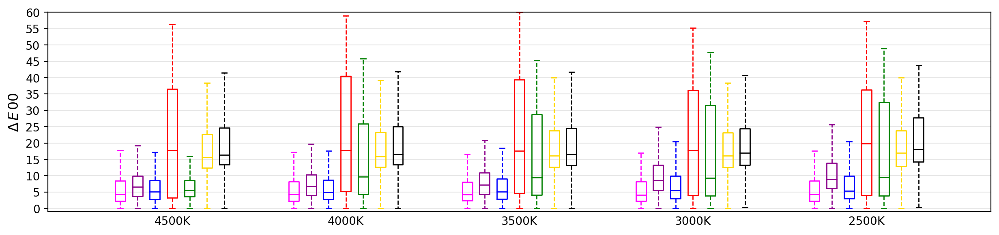

In [22]:
# FIGURE OF SET3

setf = 'match_sequential_SLRGBLx3_unique'
# setf = 'match_sequential_SLRGBLx3_weighted_unique'

image_set = 'set3'
fis = file_ids_set3
n_boxes_per_image = 7
bw = 0.07 # box width
step=0.12 # space between boxes

fig, ax = plt.subplots()
fig.set_figheight(3.2)
fig.set_figwidth(15)
fig.set_dpi(200)
our_deltas = [our_results[setf][image_set][id].ravel() for id in fis]
our_deltas_masked = [our_results[setf+'-mask'][image_set][id].ravel() for id in fis]
positions = np.array(range(len(our_deltas))) * 1.2

# Values of competing methods were read out from the boxplots of the review paper
set3_blue = [
    {'whislo': 0.0, 'q1': 2.72, 'med': 5.07, 'q3': 8.54, 'whishi': 17.17},
    {'whislo': 0.0, 'q1': 2.73, 'med': 4.99, 'q3': 8.7, 'whishi': 17.61},
    {'whislo': 0.0, 'q1': 2.9, 'med': 5.06, 'q3': 9.08, 'whishi': 18.41},
    {'whislo': 0.0, 'q1': 3.02, 'med': 5.52, 'q3': 9.96, 'whishi': 20.5},
    {'whislo': 0.0, 'q1': 2.98, 'med': 5.38, 'q3': 9.96, 'whishi': 20.43},
]
set3_red = [
    {'whislo': 0.0, 'q1': 3.22, 'med': 17.72, 'q3': 36.53, 'whishi': 56.40},
    {'whislo': 0.0, 'q1': 5.28, 'med': 17.72, 'q3': 40.44, 'whishi': 58.91},
    {'whislo': 0.0, 'q1': 4.57, 'med': 17.61, 'q3': 39.38, 'whishi': 60.00},
    {'whislo': 0.0, 'q1': 3.96, 'med': 17.69, 'q3': 36.12, 'whishi': 55.23},
    {'whislo': 0.0, 'q1': 4.01, 'med': 19.79, 'q3': 36.34, 'whishi': 57.22},
]
set3_green = [
    {'whislo': 0.0, 'q1': 3.67, 'med': 5.63, 'q3': 8.59, 'whishi': 15.96},
    {'whislo': 0.0, 'q1': 4.32, 'med': 9.64, 'q3': 25.88, 'whishi': 45.88},
    {'whislo': 0.0, 'q1': 4.08, 'med': 9.42, 'q3': 28.8, 'whishi': 45.37},
    {'whislo': 0.0, 'q1': 3.85, 'med': 9.27, 'q3': 31.64, 'whishi': 47.84},
    {'whislo': 0.0, 'q1': 3.88, 'med': 9.5, 'q3': 32.4, 'whishi': 48.86},
]
set3_yellow = [
    {'whislo': 0.0, 'q1': 12.35, 'med': 15.66, 'q3': 22.73, 'whishi': 38.44},
    {'whislo': 0.0, 'q1': 12.68, 'med': 15.89, 'q3': 23.3, 'whishi': 39.15},
    {'whislo': 0.0, 'q1': 12.69, 'med': 16.17, 'q3': 23.76, 'whishi': 40.06},
    {'whislo': 0.0, 'q1': 12.53, 'med': 16.14, 'q3': 23.15, 'whishi': 38.43},
    {'whislo': 0.0, 'q1': 12.95, 'med': 16.99, 'q3': 23.76, 'whishi': 40.00},
]
set3_black = [
   {'whislo': 0.0, 'q1': 13.35, 'med': 16.41, 'q3': 24.64, 'whishi': 41.5},
    {'whislo': 0.0, 'q1': 13.35, 'med': 16.61, 'q3': 24.97, 'whishi': 41.88},
    {'whislo': 0.0, 'q1': 13.1, 'med': 16.63, 'q3': 24.59, 'whishi': 41.73},
    {'whislo': 0.32, 'q1': 13.22, 'med': 16.95, 'q3': 24.43, 'whishi': 40.79},
    {'whislo': 0.31, 'q1': 14.22, 'med': 18.11, 'q3': 27.78, 'whishi': 43.89},
]

# Add results per author
ax.boxplot(our_deltas_masked, positions=positions+step*0, widths=bw, medianprops={'color': 'fuchsia'}, boxprops={'color': 'fuchsia'}, whiskerprops={'color': 'fuchsia', 'linestyle': 'dashed'}, capprops={'color': 'fuchsia'}, showfliers=False)
ax.boxplot(our_deltas, positions=positions+step*1, widths=bw, medianprops={'color': 'darkmagenta'}, boxprops={'color': 'darkmagenta'}, whiskerprops={'color': 'darkmagenta', 'linestyle': 'dashed'}, capprops={'color': 'darkmagenta'}, showfliers=False)
ax.bxp(set3_blue, positions=positions+step*2, widths=bw, medianprops={'color': 'blue'}, boxprops={'color': 'blue'}, whiskerprops={'color': 'blue', 'linestyle': 'dashed'}, capprops={'color': 'blue'}, showfliers=False)
ax.bxp(set3_red, positions=positions+step*3, widths=bw, medianprops={'color': 'red'}, boxprops={'color': 'red'}, whiskerprops={'color': 'red', 'linestyle': 'dashed'}, capprops={'color': 'red'}, showfliers=False)
ax.bxp(set3_green, positions=positions+step*4, widths=bw, medianprops={'color': 'green'}, boxprops={'color': 'green'}, whiskerprops={'color': 'green', 'linestyle': 'dashed'}, capprops={'color': 'green'}, showfliers=False)
ax.bxp(set3_yellow, positions=positions+step*5, widths=bw, medianprops={'color': 'gold'}, boxprops={'color': 'gold'}, whiskerprops={'color': 'gold', 'linestyle': 'dashed'}, capprops={'color': 'gold'}, showfliers=False)
ax.bxp(set3_black, positions=positions+step*6, widths=bw, medianprops={'color': 'black'}, boxprops={'color': 'black'}, whiskerprops={'color': 'black', 'linestyle': 'dashed'}, capprops={'color': 'black'}, showfliers=False)

ax.set_ylabel(r'$Δ\,E\,00$', fontsize=12, fontfamily='serif')
tick_center_offset = ((n_boxes_per_image - 1) * step) / 2
plt.xticks(positions + tick_center_offset, ['4500K', '4000K', '3500K', '3000K', '2500K'])
plt.yticks(range(0, 70, 5))
ax.tick_params(axis='x', length=0)


legend_entries = [
    ('Redistributor (masked)', plt.Line2D([0], [0], color='fuchsia')),
    ('Redistributor', plt.Line2D([0], [0], color='darkmagenta')),
    ('Pitie', plt.Line2D([0], [0], color='blue')),
    ('Hacohen', plt.Line2D([0], [0], color='red')),
    ('Faridul', plt.Line2D([0], [0], color='green')),
    ('Pouli', plt.Line2D([0], [0], color='gold')),
    ('Reinhard', plt.Line2D([0], [0], color='black')),
]
plt.grid(alpha=0.3, axis='y')
# plt.legend(handles=[entry[1] for entry in legend_entries], labels=[entry[0] for entry in legend_entries])
plt.ylim(-1, 60)
plt.savefig(pj(path, 'results', f'set3_boxplot-{setf}.pdf'), bbox_inches='tight')